## PSF Photometry on the PAL5 globular cluster - epochs

This notebook works through the PSF photometry method detailed in the previous notebooks but extends the analysis to all 12 time epochs for the Palomar 5 data.

In [1]:
import math
import glob
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.colors import LogNorm
from astropy.io import fits # used for FITS file management
from astropy.stats import sigma_clipped_stats # used within star detection
from astropy.table import Table
from astropy.nddata import NDData
from astropy.visualization import simple_norm
from astropy.modeling.fitting import LevMarLSQFitter
from photutils import aperture_photometry # used to perform photometry using annuli
from photutils import DAOStarFinder # used for the star finding algorithm
from photutils import CircularAperture, CircularAnnulus
from photutils import EPSFBuilder
from photutils.psf import extract_stars
from photutils.psf import DAOGroup
from photutils.psf import IterativelySubtractedPSFPhotometry
from photutils.background import MMMBackground

EPOCH NUMBER: 1
FLUXCONV = 0.1257
EXPTIME = 71.3724


Number of model stars = 55


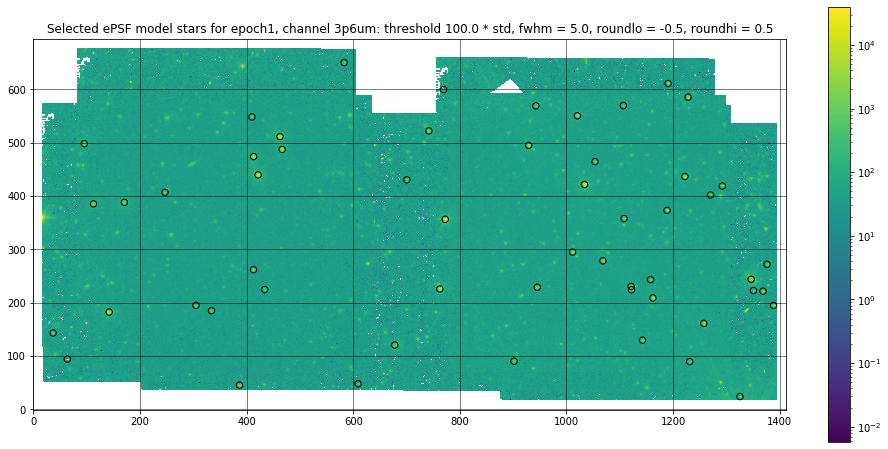

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1 1325.4233008232586 ... 10121.479821030493                nan
  2 386.74295292483225 ...  5529.953810103007 38796.442407212395
  3  609.1207788533914 ...   4242.52160498129 10810.107057863164
  4 1231.1472298861074 ...  6433.421803627419 13631.483674701412
  5  901.5972881997893 ...  6920.332616385321 27140.962177024063
  6 63.841924403069605 ...  4474.694199170145 122977.99359934543
  7  678.0489555778879 ...  8119.679761777776 36700.064011868526
  8 1142.6191445428262 ...  6213.305147945754  33401.67795837177
  9  37.04180690341026 ...   6146.12836619762 18512.549970873857
 10 1257.6453165205398 ...  6496.728208037017  73457.07486642095
...                ... ...                ...                ...
 46  462.5830654773494 ...  9349.565828127556 322328.20533513353
 47  741.8625043432492 ..

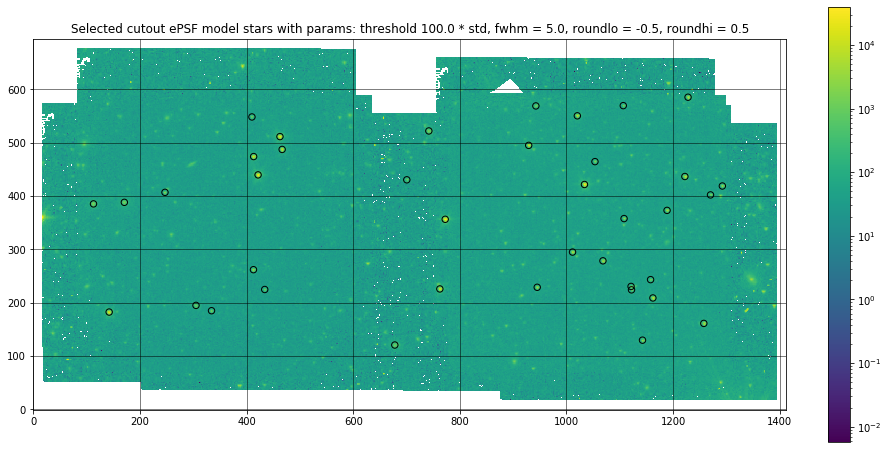

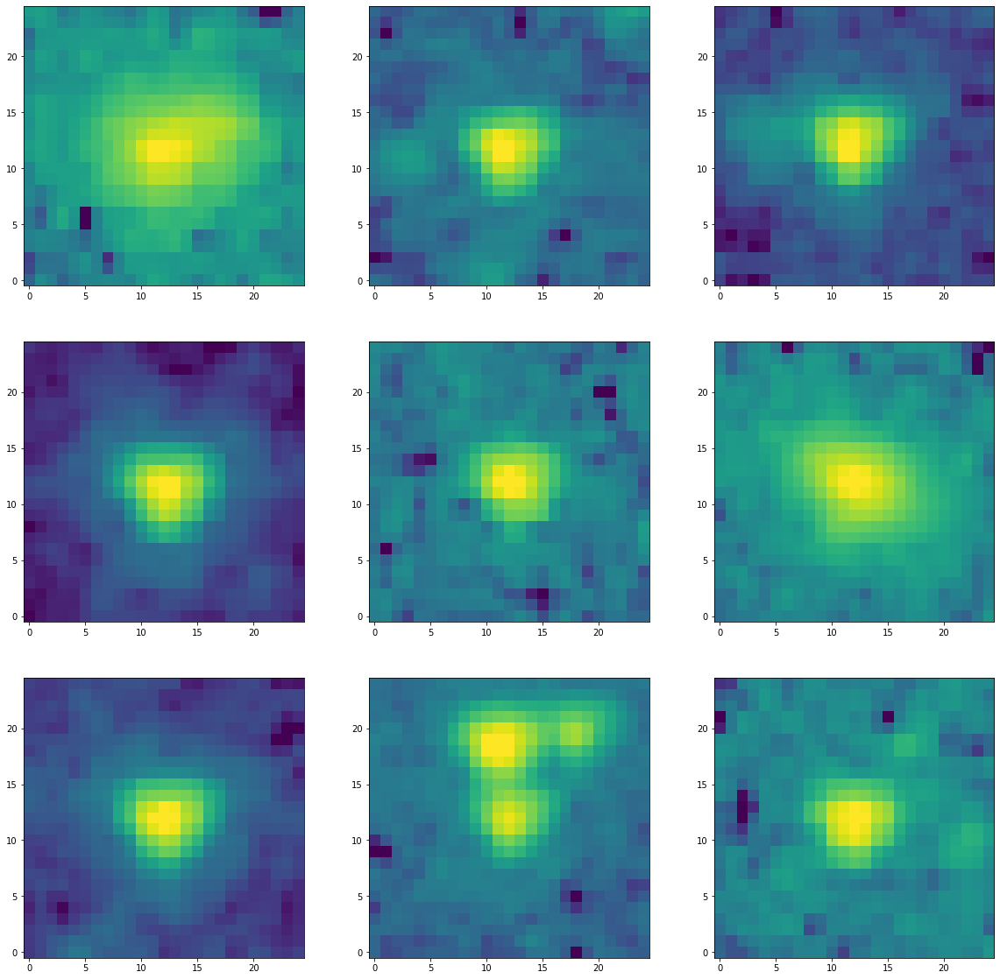

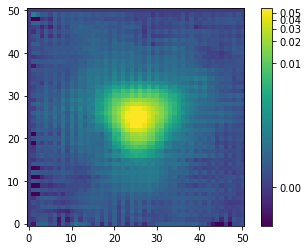

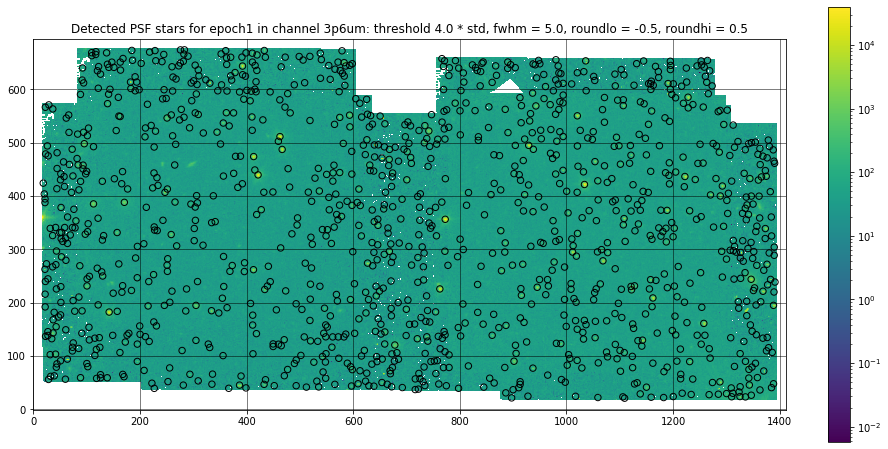

Number of stars detected = 1241


1722


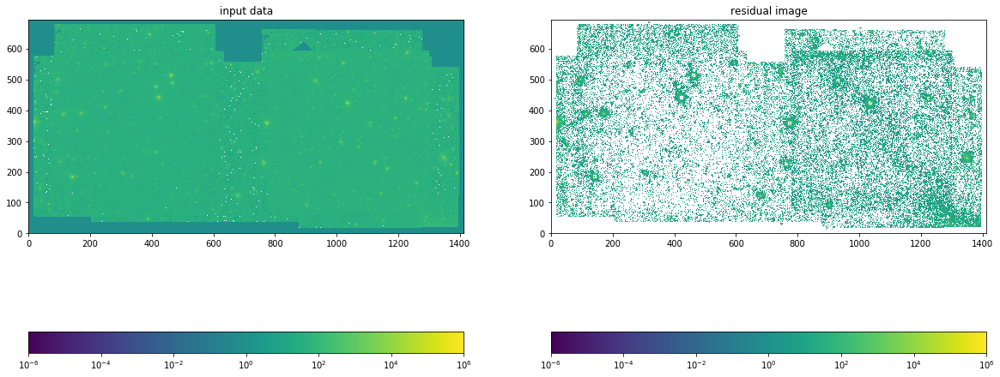

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 890.76936 20.689356 -1268.5776          nan
  2  906.4629 19.992447 -2206.8188          nan
  7 897.14841 21.727674 -628.10912          nan
 21 881.61175 28.613573  720.31535      18.4138
 27 886.23986 30.962482   51.55709    21.276885
 32 899.91997 36.837945  -678.3775          nan
 43 910.48561  40.64482   906.0155    18.164767
 62   913.037 46.901097  644.76043     18.53411
 77 913.11422 51.825176  462.26868     18.89537
  3 950.87372 19.319883 -2622.4375          nan
...       ...       ...        ...          ...
394 435.40497 660.60773 -322.14599          nan
391 795.04913 658.30516 -1436.7869          nan
398  1002.019 664.37324  -64.10609          nan
399 352.24613 666.65468 -164.14286          nan
400 133.78051 667.39208  172.94904    19.962811
401 84.656537 670.35938 -1700.3777          nan
404 84.241854 677.04408 -2567.1731          nan
402 184.68995 673.18239 -887.14951      

Number of model stars = 52


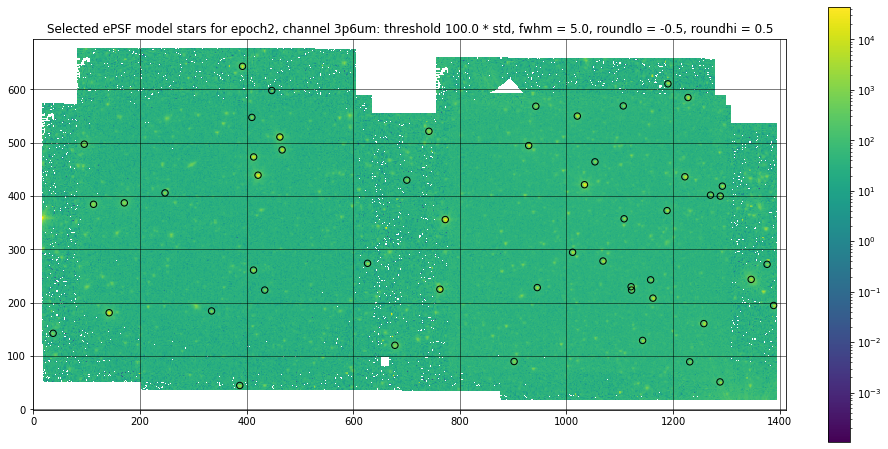

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1 387.20865058168016 ...  4464.925282206993  37819.95977923774
  2  1288.019934867026 ...  7621.010267227235  33253.04792246037
  3  1231.220846106492 ...  5741.828387011363 13163.689917826527
  4  901.7533111560487 ...   5926.71257195687 27501.142832834536
  5  678.2263781517587 ...   7492.38267051695 36338.598326255684
  6 1142.8097026322089 ...  5391.401333726652  32979.64467343563
  7 37.093797138884966 ...  4851.756575802207 18457.432496241865
  8 1257.6873364244952 ...   5775.15004499171  75953.57315842151
  9 142.21993764730817 ...    8362.0876510262  292319.4313537541
 10 334.27143122646214 ...  3949.868702331567  17674.76728038909
...                ... ...                ...                ...
 43  462.4672705496683 ...  8418.918906814084  327498.0643716573
 44  741.9823280356661 ..

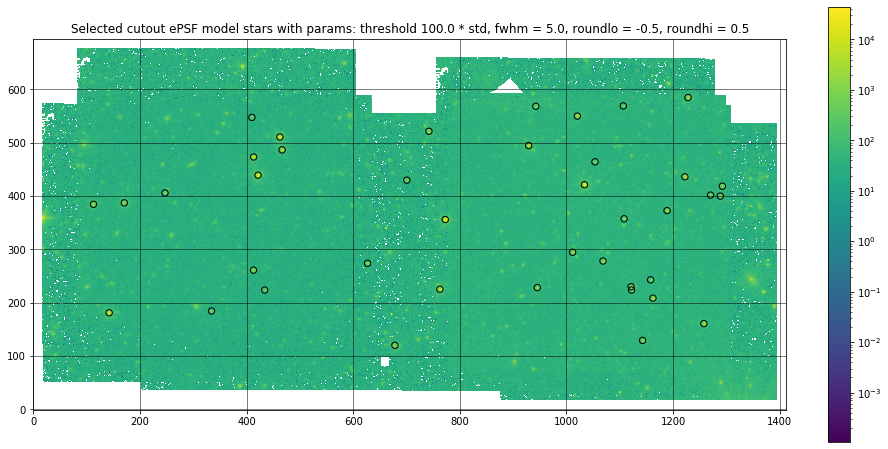

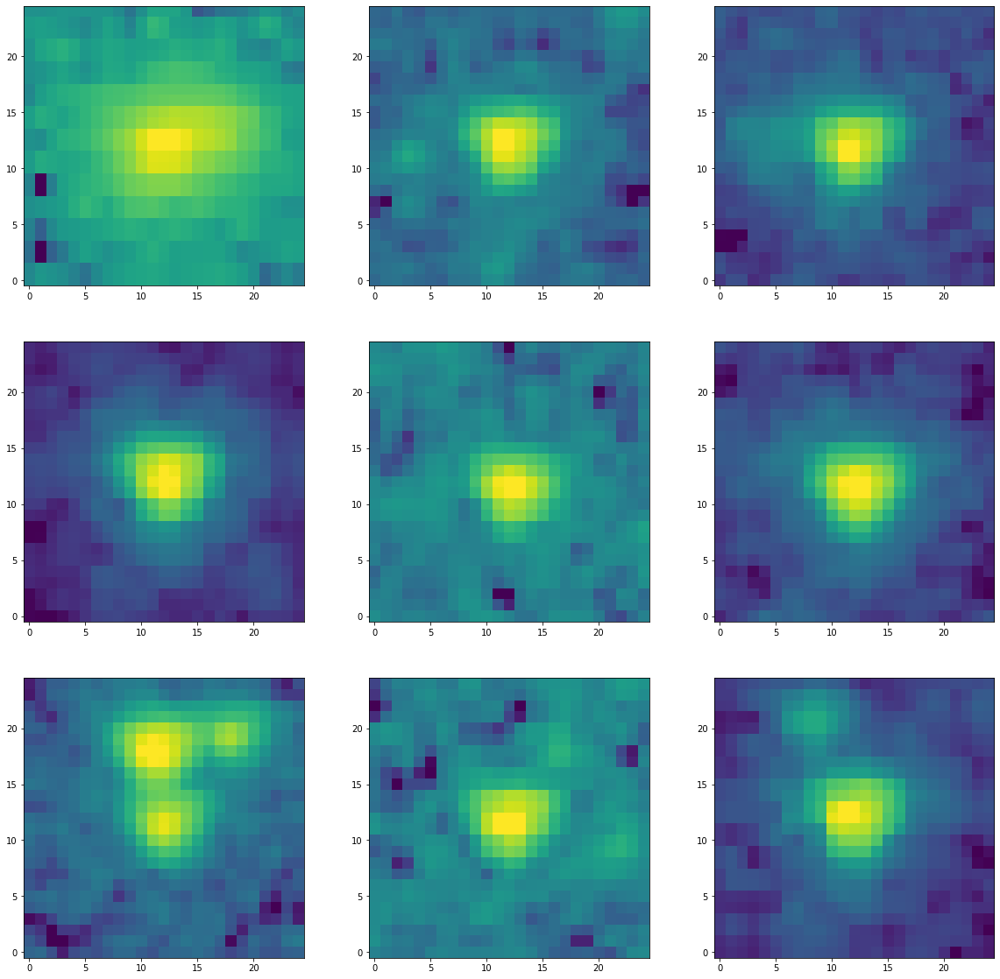

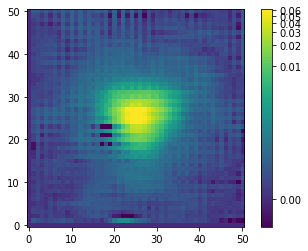

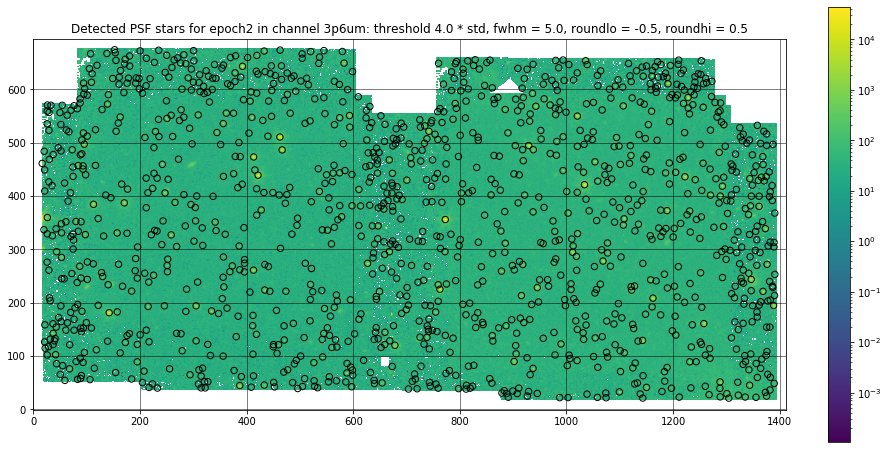

Number of stars detected = 1292


1834


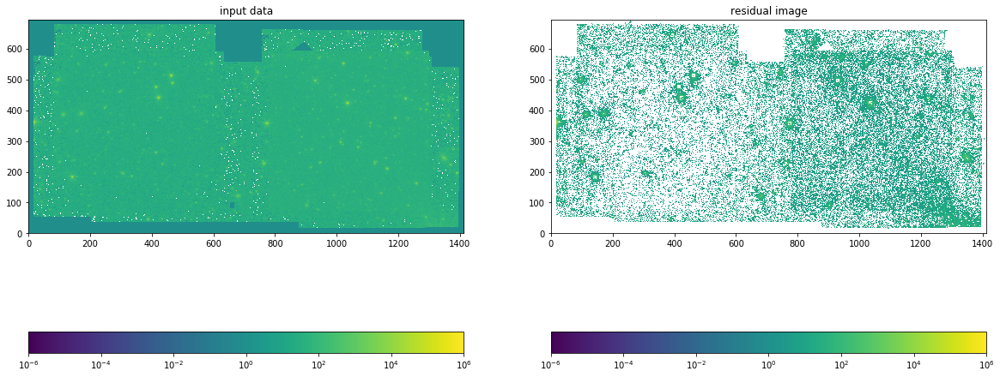

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 918.25742  19.48493  -1674.494          nan
  2 938.98577 20.132528 -1182.0665          nan
 10  879.3538 22.499743 -1201.9184          nan
 16 926.69909 24.867117 -656.40719          nan
 21 887.60501  29.62468 -918.27126          nan
 22 907.55086  29.73064 -1035.8455          nan
 23  945.2447 29.781673  100.53301    20.551378
 28 899.43581 34.392841 -898.21982          nan
 29 929.01918 33.571363 -499.41605          nan
 31 883.24185 35.033343  271.66689    19.472058
...       ...       ...        ...          ...
451 212.08162 658.46123 -990.88113          nan
456  379.3837 663.18024 -70.826135          nan
457 411.56817 665.03219  1283.6716    17.786015
460 605.46754  669.4355 -1840.8202          nan
461 579.71274 671.26486 -544.87161          nan
464 235.08617 673.46876 -933.76358          nan
469 248.26161 676.37167 -1451.8313          nan
470 253.72659 675.87118 -1018.5914      

Number of model stars = 56


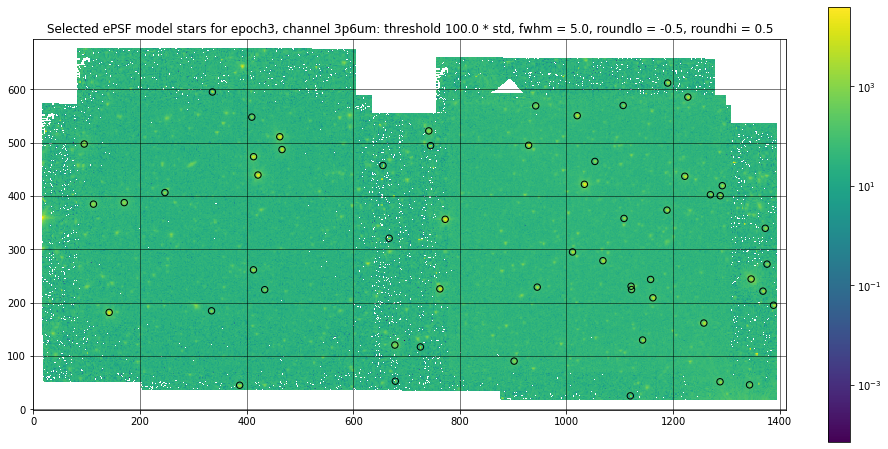

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1  1119.793559095858 ...  4326.920940309359 10372.619125261008
  2  387.0199178517202 ... 4566.9430100636255  38169.42970941812
  3 1343.4099957729359 ...  6503.104774424659 15697.557278535636
  4 1288.0380832633464 ...  7510.629659610248  33337.99080980889
  5  678.9604355869549 ...  2725.238773214579  11737.22399616475
  6  901.7634940639969 ...   5906.47538660199 27060.818934347277
  7  726.0565290066081 ... 3230.7433386134153 17613.480593670247
  8   678.135241273232 ...   6338.31863798288   36594.5362658275
  9 1142.8011768511344 ...  5378.730820197866  33733.25171301132
 10 1257.6779486222315 ...  5783.037486581621  72579.53124571903
...                ... ...                ...                ...
 47  95.43600927113096 ...  6373.918257433238  45284.98053555313
 48 462.27319028195035 ..

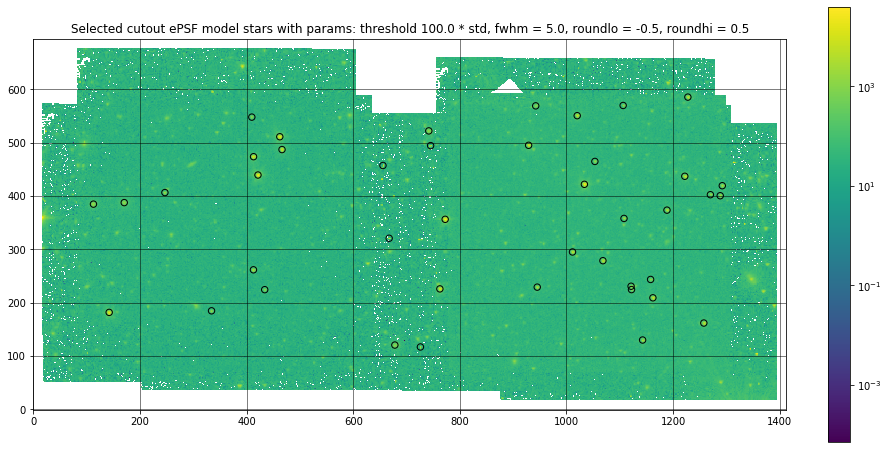

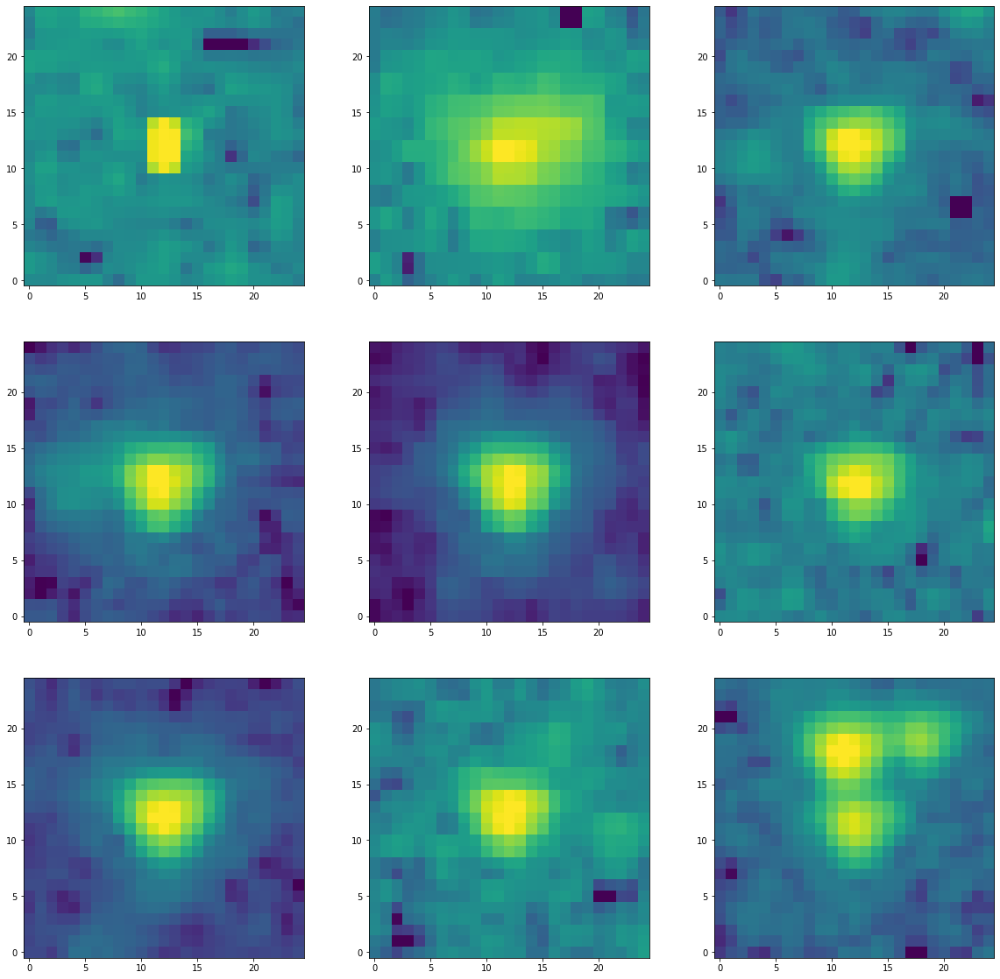

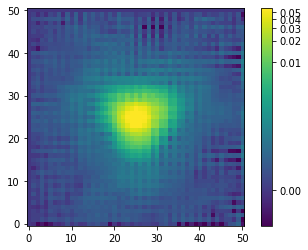

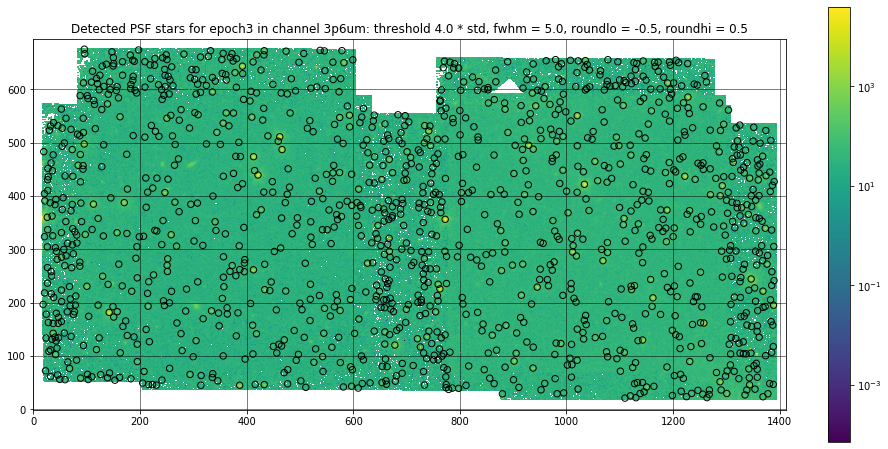

Number of stars detected = 1308


1819


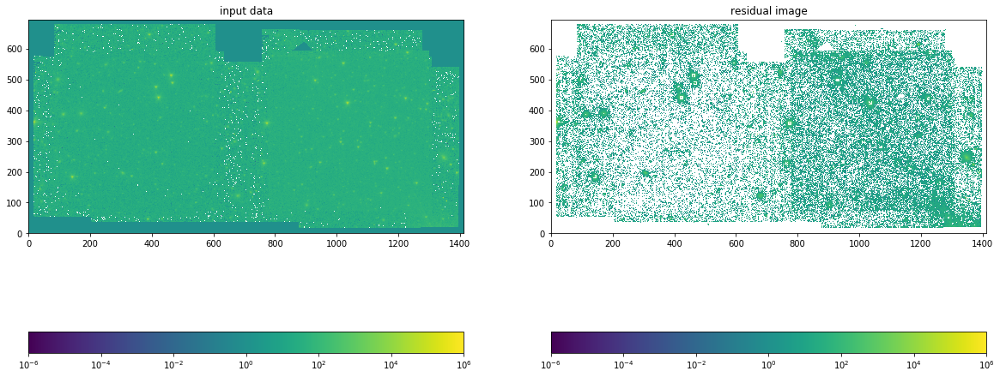

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 897.56771 19.824865 -1208.8235          nan
  2 913.83194 20.223036 -478.02433          nan
  9  879.5272 21.606468  13421.205    15.238193
  3 1010.8942 19.488794 -849.00073          nan
 17 982.44968 29.275608   162.9093    20.027807
 18 994.82769  30.89305  120.77158     20.35276
  4 1251.0161  20.08008  1816.0606    17.409846
 10 1263.5218   21.9942  3682.4187    16.642339
 11 1225.1634 23.828951  732.20909    18.396084
 13 1198.7198  26.08576  343.55372    19.217685
...       ...       ...        ...          ...
414 1069.0868 662.35035 -1113.1915          nan
412 213.36509 659.07382 -675.48729          nan
416 507.51596 667.37561  -419.5242          nan
425 515.38469 675.67765 -899.60838          nan
417 356.06344 667.82559 -218.38725          nan
418 147.56094 670.36921 -403.10883          nan
419 332.31295  672.3843 -736.86201          nan
420 986.01594 673.46268 -2513.4502      

Number of model stars = 51


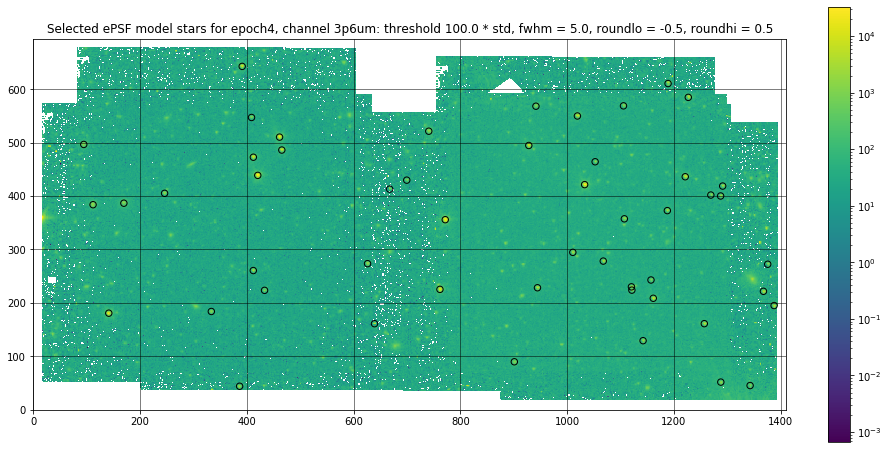

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1  386.3493258304752 ...  4151.968753659516   38434.0199249713
  2  1342.543710978572 ...  6619.935939033854 15970.647339868494
  3  1287.670713291212 ...  7426.322650750849 30807.499339826634
  4  900.9166758345501 ...  5639.622339044568  27290.16831171931
  5 1142.0735793966658 ...  4987.780860092528  32934.20533614487
  6  639.0408390408697 ...  2624.159841600133 41988.439902887505
  7 1256.7846250031262 ...  5301.843796251718  74057.46707184304
  8  141.3045222505925 ...   7848.70804771023 295682.33155768923
  9  333.3813046236053 ... 3501.3818792443676 17257.644351876916
 10 1387.5155623290373 ...  5152.368322053826                nan
...                ... ...                ...                ...
 42   94.4436966573878 ...  6252.681308253636  38585.45519683053
 43  461.1978804847405 ..

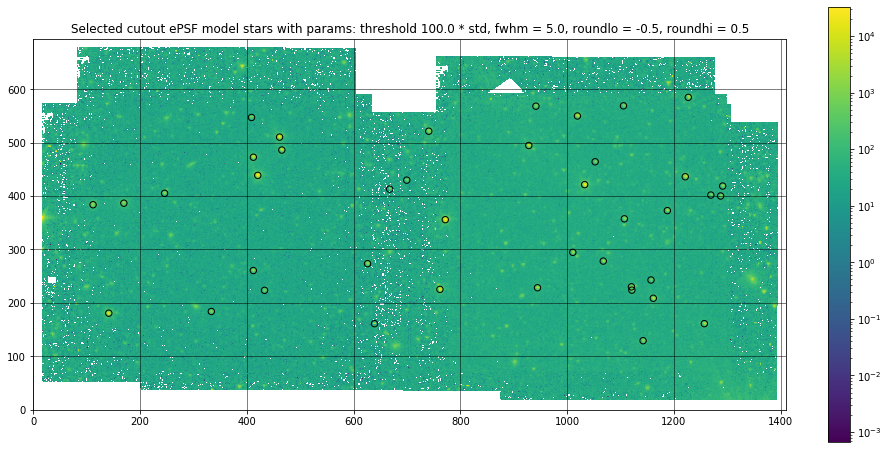

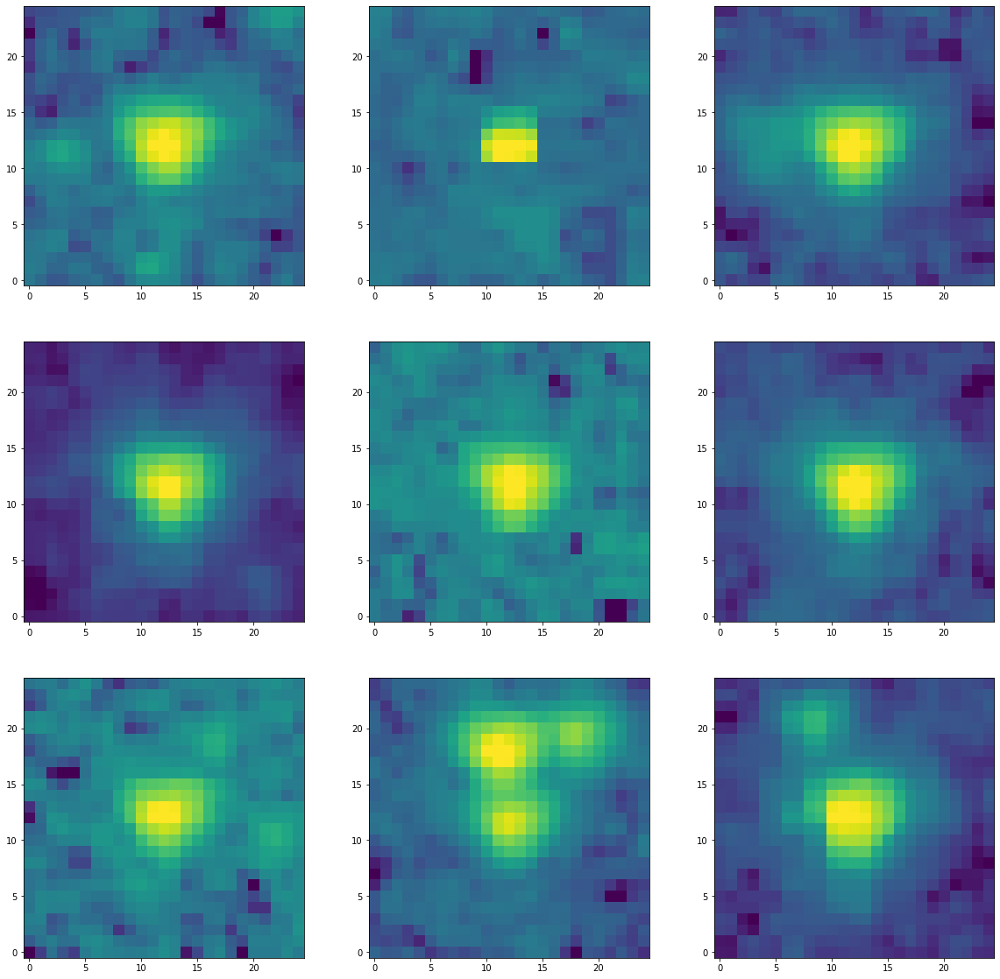

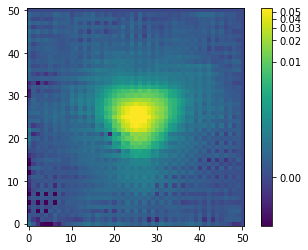

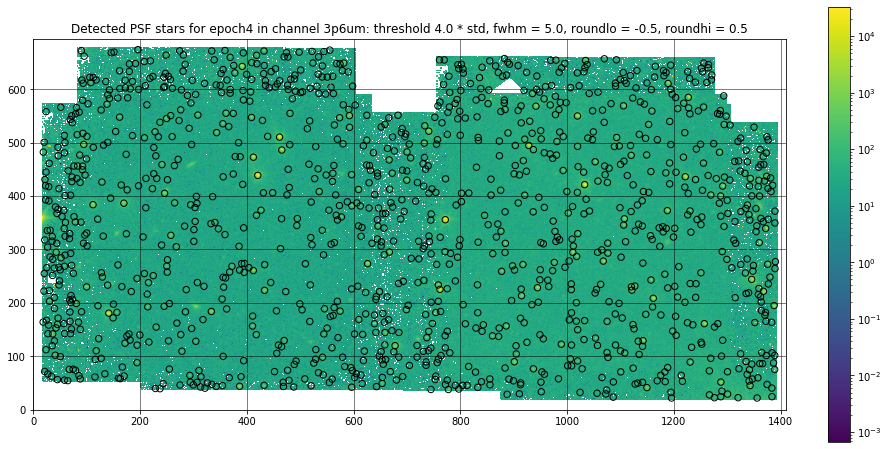

Number of stars detected = 1249


1692


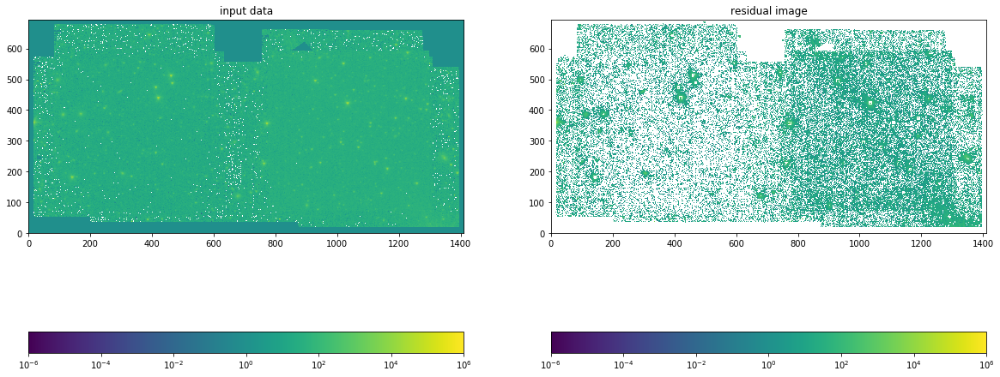

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 881.57452 20.477017  -1243.981          nan
 18 875.68925 25.587193 -402.98309          nan
 20 887.33204  28.44498  134.30161    20.237187
  2  966.7124 20.270176  -28.15926          nan
  3  988.9492  21.10294 -777.42235          nan
  4 1039.7646 21.022012 -1026.0124          nan
 15 1086.2136 23.304103 -189.86688          nan
 24 1072.3655 29.342944  330.09743    19.260785
 25 1055.9377 30.719055  254.48309    19.543243
 28 1024.0064 32.267138  695.11161    18.452254
...       ...       ...        ...          ...
370 393.11807 668.09779   -401.211          nan
371 584.07671  668.1954  23361.046    14.636159
372  474.9388 668.44121  375.70971    19.120259
373 501.92282 669.80247  151.90801    20.103439
375 477.71454 673.64611 -952.08022          nan
376 488.74809 673.67993  128.62391    20.284086
379 495.50372 675.06039 -1288.0483          nan
374 197.39863 671.33186  -647.2963      

Number of model stars = 51


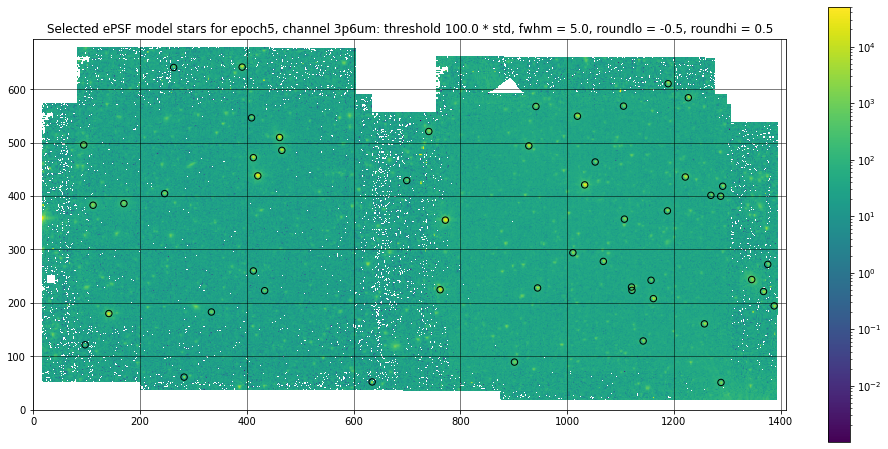

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1 1287.9841244104587 ...  7519.832106230573 31613.171490952478
  2  634.6629259446132 ... 2782.1513539526713  45922.28715939837
  3  282.3498157313134 ...  2895.405299332967  20956.83582277249
  4  901.1562728600691 ...   5751.73708797381 27232.989381143074
  5  96.98871783593124 ... 2578.7506427115195  8451.863978402125
  6 1142.2193101872708 ...  5049.366066152769  33314.29544307452
  7 1256.9584366471229 ...  5184.197656412059  74103.52958432381
  8 141.44429514317775 ...  7818.515998158567  289550.0938561747
  9  333.5452327449955 ... 3315.9221638820045 17675.323116198295
 10 1387.6071206681752 ... 5073.2902702051315                nan
...                ... ...                ...                ...
 42  461.2498360980922 ...   8127.76307353954  326750.0365033802
 43  740.7481776706853 ..

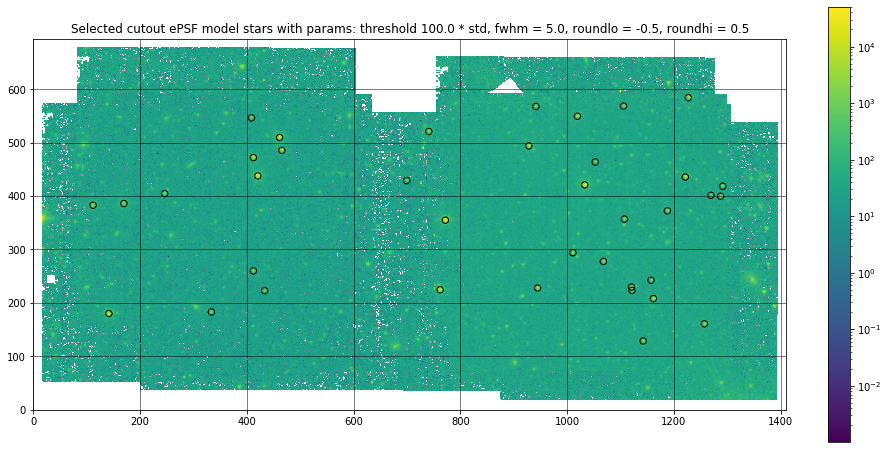

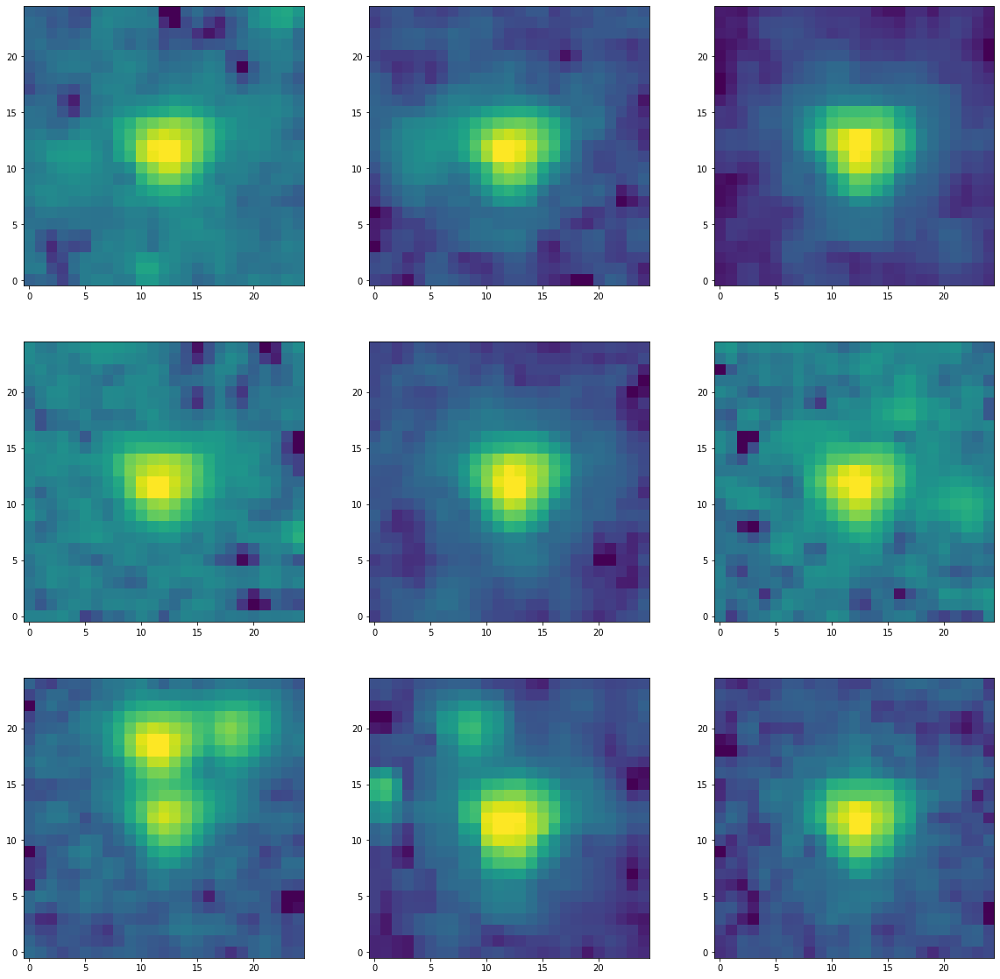

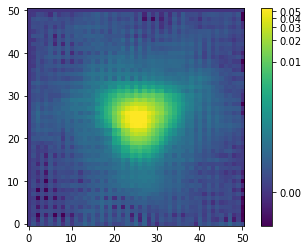

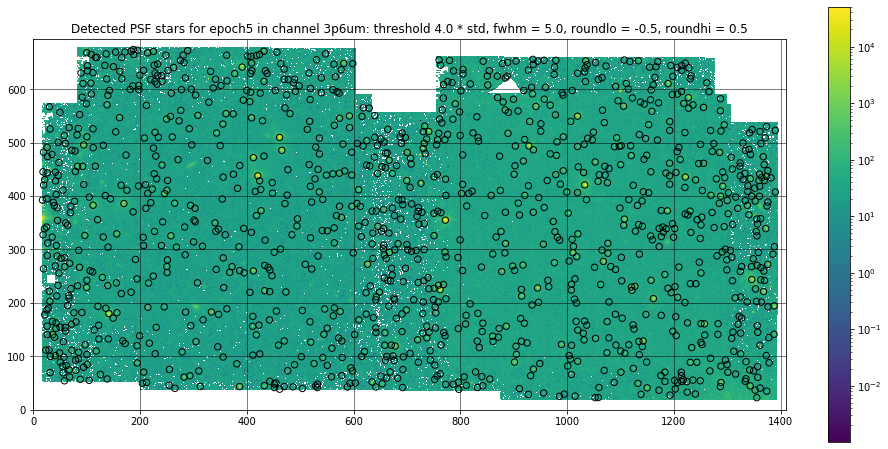

Number of stars detected = 1215


1669


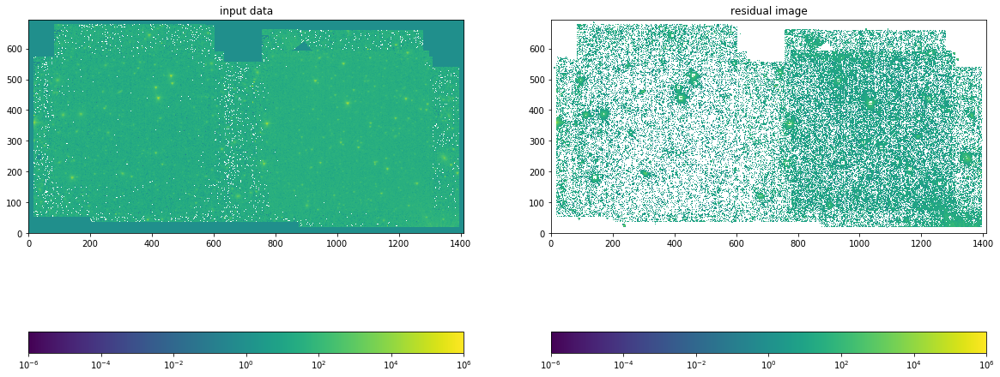

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 921.91072 20.416893 -968.80489          nan
 15 927.26224  28.63877 -357.09513          nan
 39 910.39613 39.255448  1269.4146    17.798383
  2 999.84219  20.46268 -642.02346          nan
  3 1015.3877 21.638435 -124.91792          nan
 11 985.51134 25.040651 -585.38553          nan
 13 1014.7727 25.344677   556.6145    18.693505
 16  994.3673 29.020613  581.73393    18.645581
  4   1090.38 20.292054 -1326.7693          nan
  6 1080.1583 20.561101 -266.45606          nan
...       ...       ...        ...          ...
348 1011.1248 657.89743 -1097.9561          nan
353 843.65406 659.01398 -484.52288          nan
356 843.63477 665.78421 -1110.9763          nan
355 401.74486  662.3796 -171.50656          nan
358 134.80187 669.07154 -390.44943          nan
364 142.16131 676.35732 -1443.3917          nan
359 183.04046 671.22828 -1399.2654          nan
360  187.2473 674.58768 -1619.2512      

Number of model stars = 49


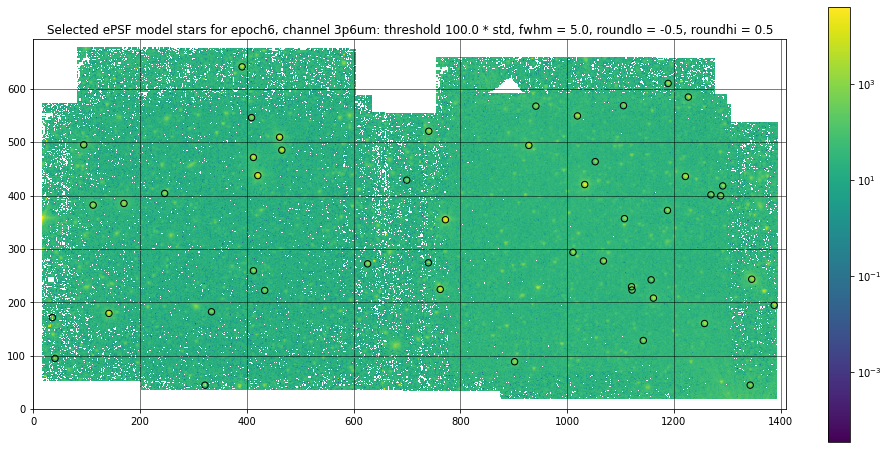

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1  321.4307068970402 ... 2718.7549959509333 63147.427128671494
  2  1342.716450135009 ...  6326.060357822387 15436.196257477388
  3     901.3816303753 ...  4458.329116882185 27598.249971668345
  4  40.57090296245627 ... 3010.5771760986663  15826.40679996479
  5  1142.458838598623 ...  4236.367657555489  32797.40202689057
  6 1257.1315977546737 ...  4409.921572780276  74128.04012346923
  7  35.70502499840189 ... 2467.7255834002467  22051.13890960703
  8  141.5540674582933 ...  6569.939214804145  291325.8122774518
  9  333.6959124708995 ...  2535.986554007117  17875.36272632036
 10 1387.6251878280566 ...   5067.08584522403                nan
...                ... ...                ...                ...
 40   94.4528658362162 ...  5237.975667252356  38531.02354584171
 41  461.2673570580443 ..

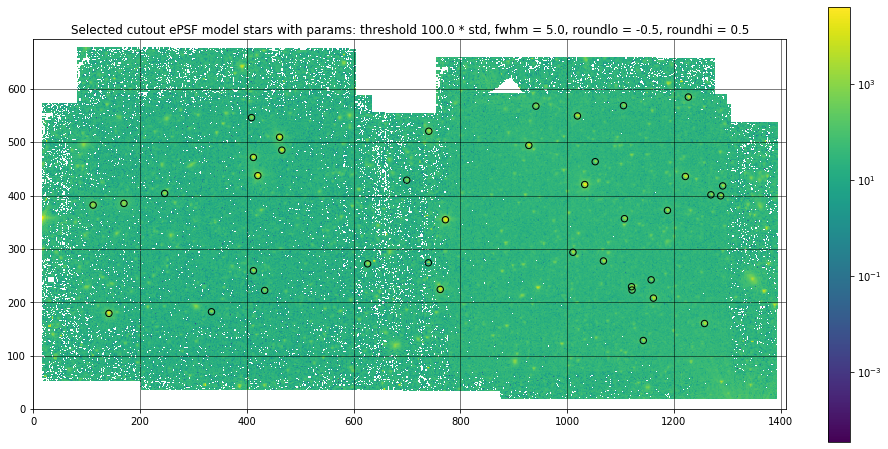

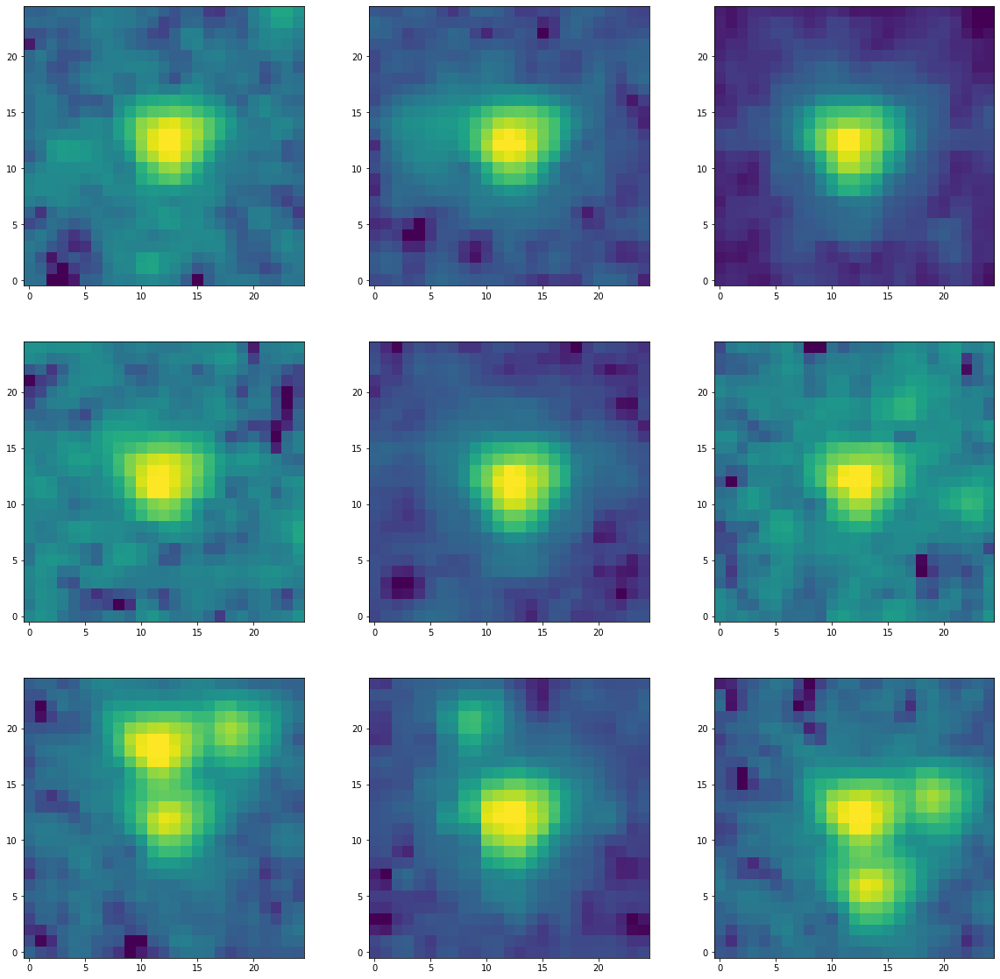

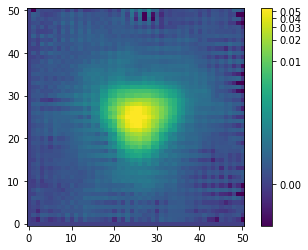

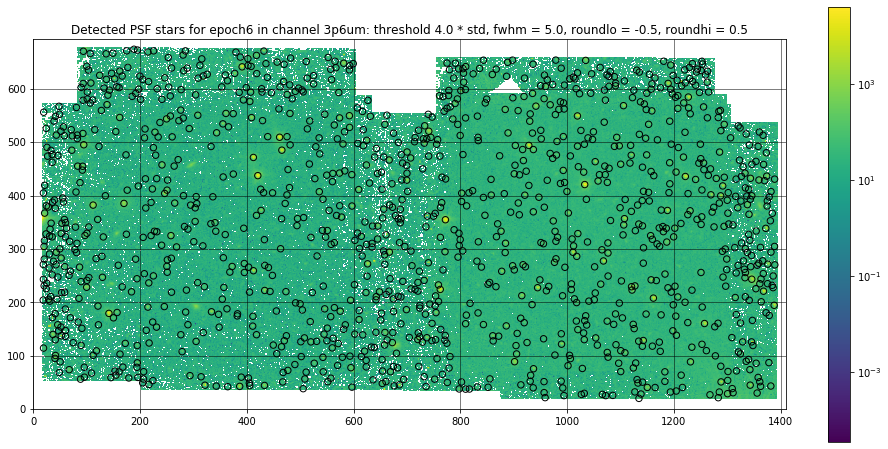

Number of stars detected = 1255


1639


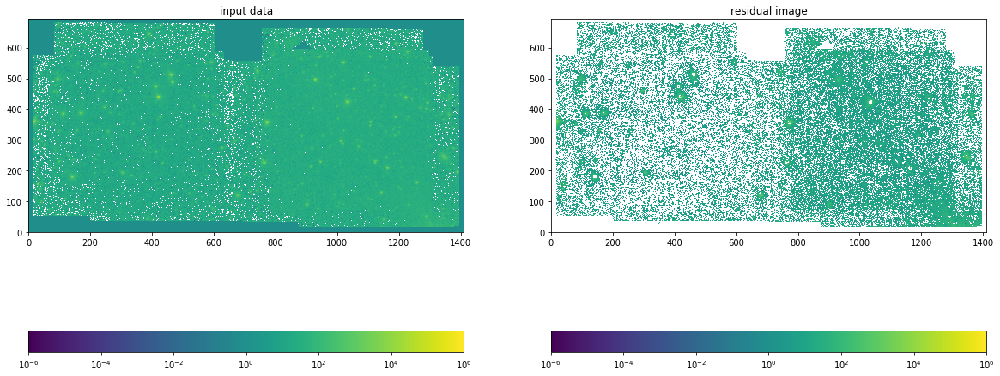

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 882.05013 19.280559 -462.31137          nan
  2 1232.8087 20.481102  1728.8875    17.463089
  9 1241.8104 23.840294  2977.6953    16.872805
  3 1092.5928 20.165188 -156.63537          nan
 11 1072.0053 25.248333  776.21539     18.33255
 12 1085.2158 25.646282 -20.703945          nan
 15 1065.8265 27.501853  443.08343    18.941292
  4  1134.195 20.241924  903.66324    18.167489
 17 1138.1841 28.213359  3021.0163    16.857123
 23 1126.6435 32.188695  1086.9018     17.96703
...       ...       ...        ...          ...
303 96.088629 659.59379 -612.62477          nan
304 102.63719 660.49709 -1041.5539          nan
306 106.39073 666.24221 -359.35061          nan
311 104.46522 675.59131  347.75443    19.204324
305 414.19457 661.05262  1325.9074    17.751223
307 233.95877  668.2277  4460.3085    16.434094
313 240.22725 675.76202 -1313.2031          nan
308 555.50367 673.07272 -1104.7239      

Number of model stars = 58


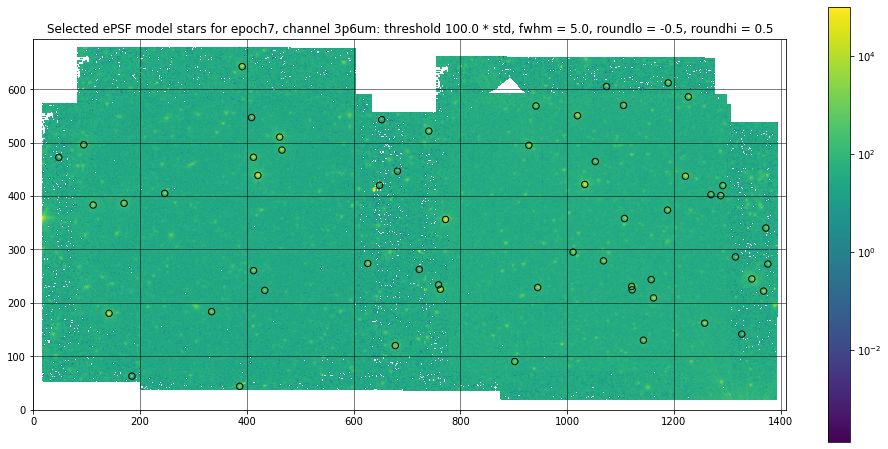

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1  386.5506642002301 ...  4789.785669447612  43598.69377618806
  2 184.60225815376754 ...  4125.692166100481 20473.958892173003
  3  901.7198843533403 ...  5582.326215172605 27549.146385238248
  4  678.0117391587786 ...  6966.468239066573   36842.2560571589
  5 1142.6814037543315 ...  5582.179096827666 33532.186310811194
  6 1326.9315524225294 ...   3529.81077367528 14919.802363652547
  7 1257.3354192125503 ...  5880.378921943283  71647.89916968199
  8 141.73525826508785 ...  8043.656249172959 289473.49610691203
  9  333.9496582862695 ...  3953.046199722973 17949.856843420366
 10  1161.577732853614 ...  5812.816224184748 101439.53978544362
...                ... ...                ...                ...
 49  740.7577280508764 ... 7056.8222001918175   36992.3470073521
 50  652.4910304707462 ..

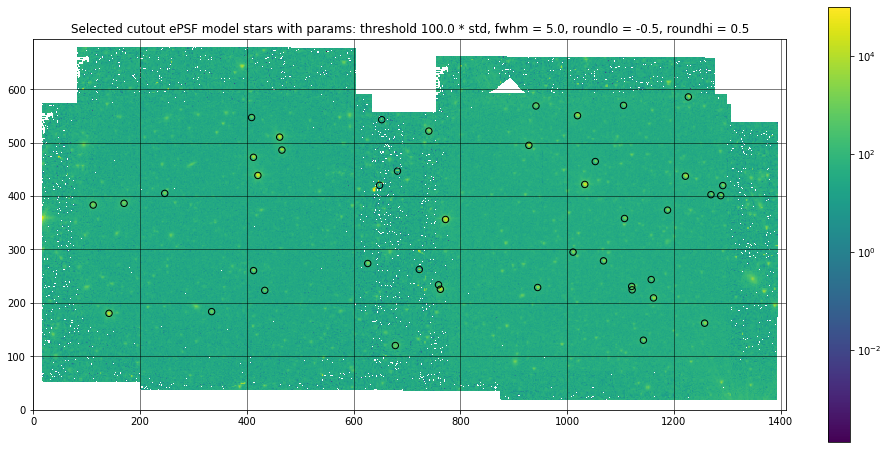

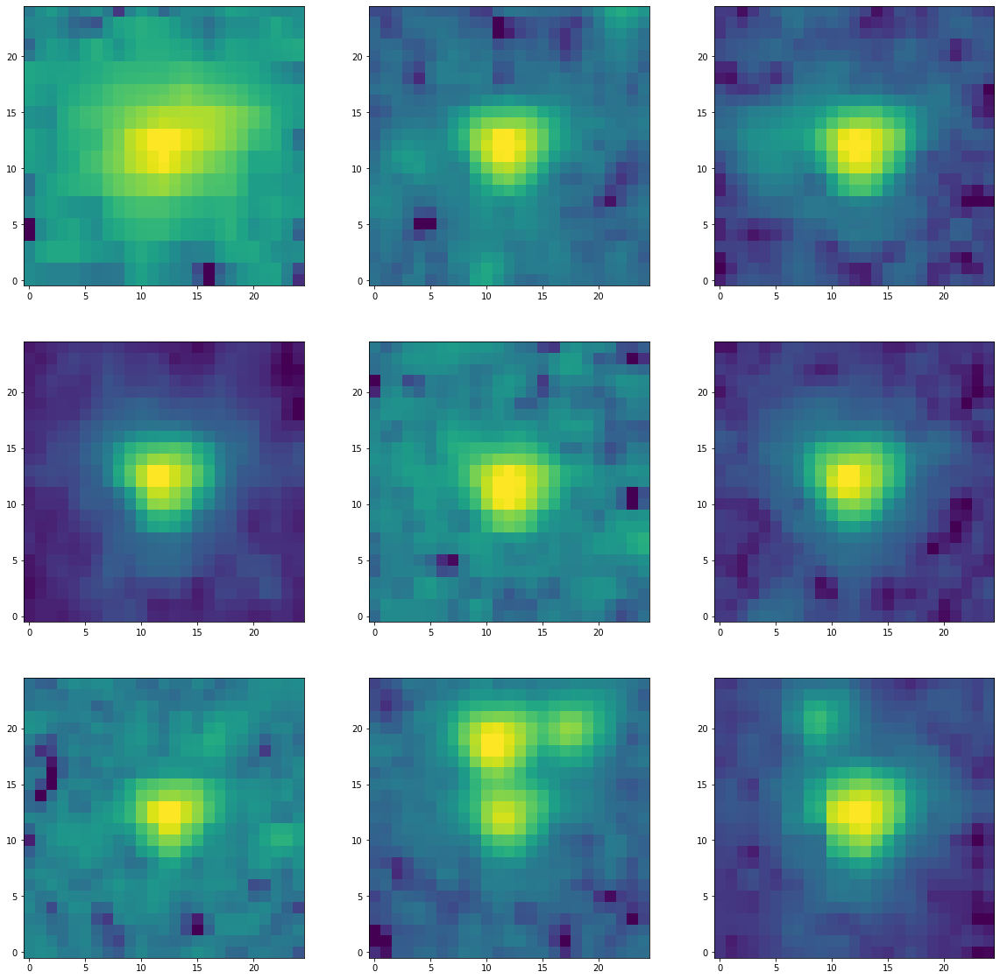

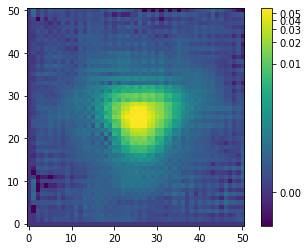

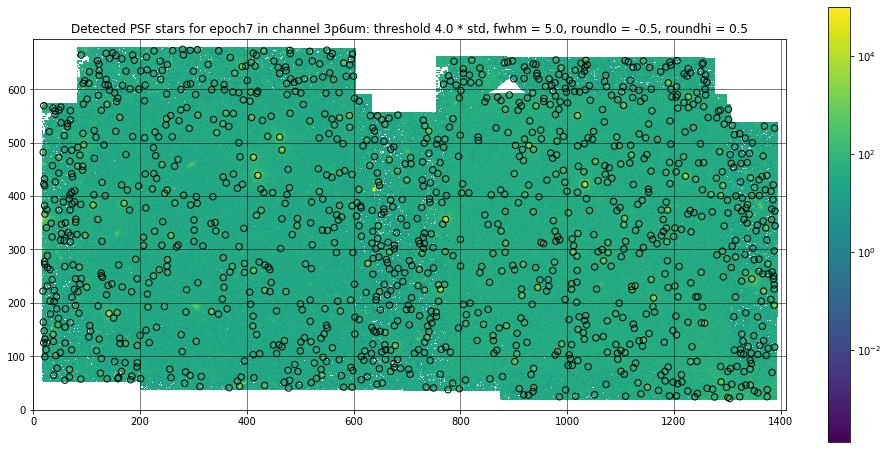

Number of stars detected = 1266


1756


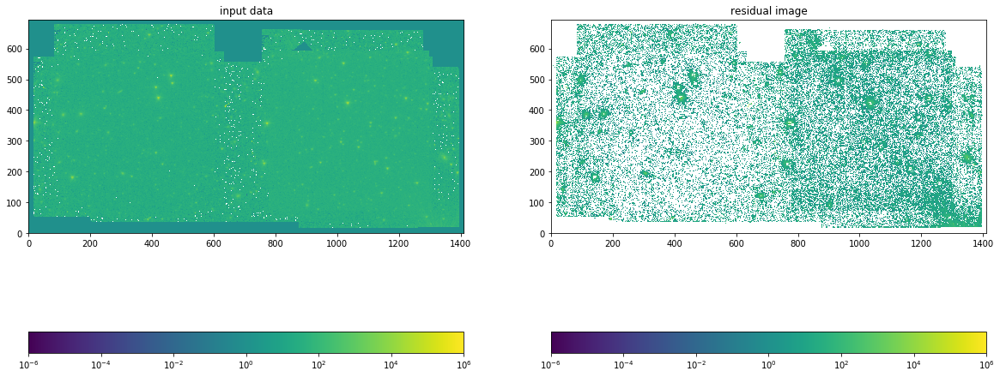

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 925.12691 19.199843 -1052.9342          nan
  2 930.84333 19.930251 -792.93422          nan
  5 936.51658 19.993279 -1175.3021          nan
 14 918.57507 27.613847 -1112.8318          nan
 15  927.6828 27.109456 -135.48187          nan
 19  935.9443 33.779037 -628.50161          nan
 39 910.25658 39.261468  720.22844    18.413996
 42 937.26558 41.143671 -322.43115          nan
  3 986.94252 19.345754 -1539.0158          nan
  7 985.43894 24.041122 -514.59133          nan
...       ...       ...        ...          ...
401 165.70397 657.06369  105.59694    20.498543
402 142.95688 658.36366 -643.72506          nan
403 1062.4909 657.57754 -1286.4797          nan
404 1069.7396  657.2382 -1437.9379          nan
410 481.29578   666.982 -223.77012          nan
415 458.76615 674.56951 -1569.2671          nan
416 467.20189  674.8758 -542.27275          nan
417 475.51053 677.22746 -833.27846      

Number of model stars = 46


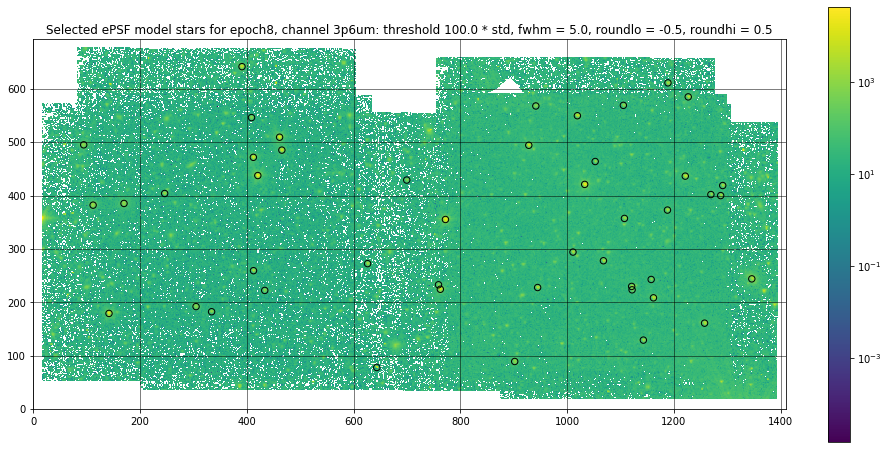

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1  643.2518141417822 ... 1359.6376515297122  174450.5862378494
  2  901.6345475886154 ...  4008.344145839567 27555.939847261077
  3  1142.631182881592 ...   3997.34003878387 32830.473825452886
  4 1257.2707614218302 ...  4284.862782373007  72166.21264436975
  5 141.70604293502348 ...  6284.121706576791 290376.36929384305
  6 333.87853144973195 ... 2178.8126577378634 17962.861872950663
  7   304.769737479489 ...  2929.952763757759 27244.150020381716
  8 1161.5297769177594 ...  4177.594957332937 100820.21369486384
  9  433.4244998211117 ... 1772.6193387957078  17842.20296315395
 10  1121.508156372656 ...  3797.410306617832   30823.9817485777
...                ... ...                ...                ...
 37  927.9832524131256 ...  6057.416435632009 152280.13091170316
 38  94.37248363041797 ..

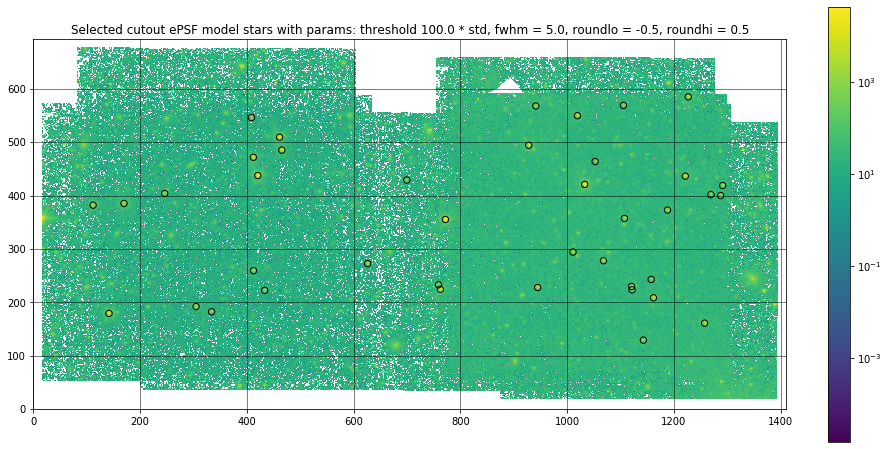

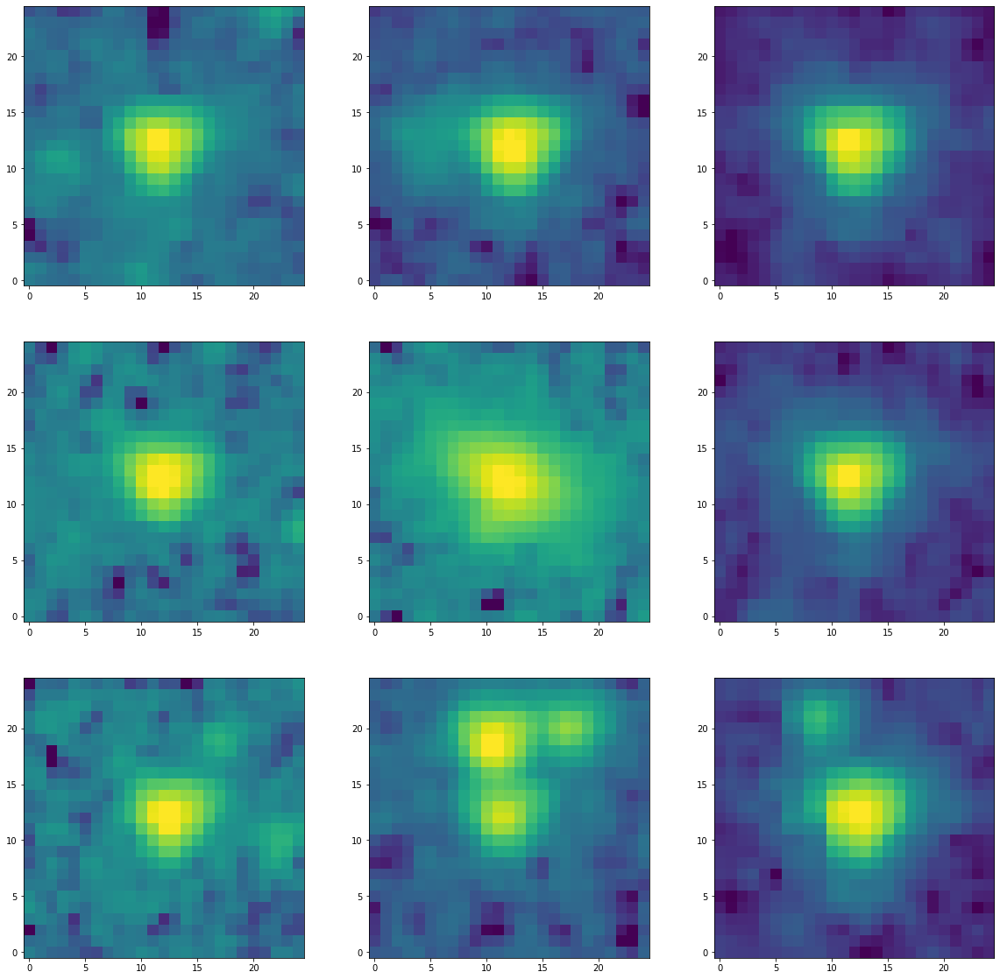

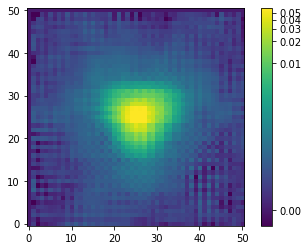

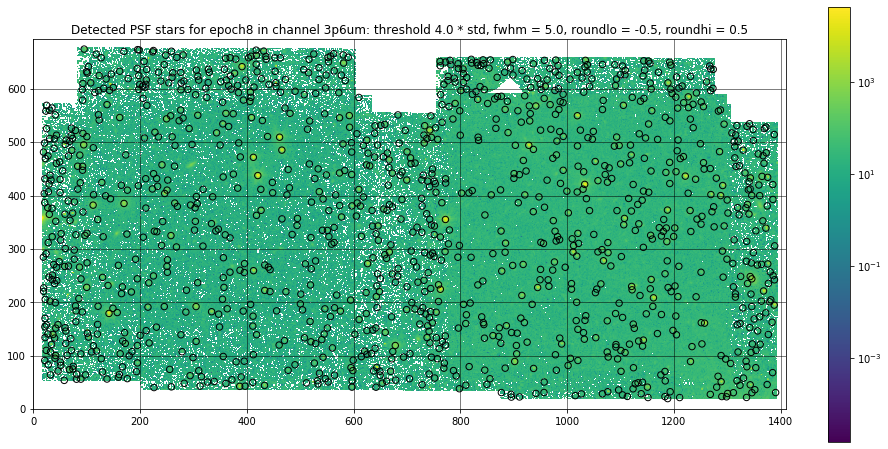

Number of stars detected = 1236


1626


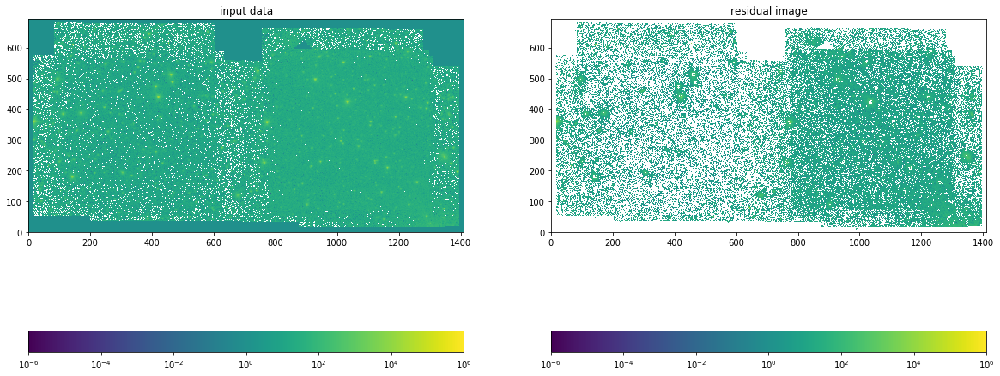

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 888.23861 18.690258 -1193.5737          nan
  2 902.52607 18.925364 -714.46628          nan
 16 895.34279 22.443776 -637.85698          nan
 17 910.62176 22.699453 -428.51099          nan
 23 894.70609 27.607084 -743.80842          nan
 30 876.73379 30.910559 -948.78373          nan
 37 857.68507 34.743187 -264.99668          nan
 65 849.56633 46.373414  368.62893    19.141426
 97 855.28503 56.820177  2426.0085    17.095669
128 845.53359 72.930721  1826.7701     17.40369
...       ...       ...        ...          ...
325  372.5999 657.03089  66.233958    21.005198
326 452.62237 658.04813 -329.48695          nan
327 462.72269 658.19225 -500.99698          nan
328 815.06222 657.73209 -125.17959          nan
329  834.9615 656.97799 -246.18203          nan
330 839.68587 657.66166 -35.857462          nan
331 883.23341 658.14334 -963.00981          nan
332 580.26845 663.45443 -443.79772      

Number of model stars = 50


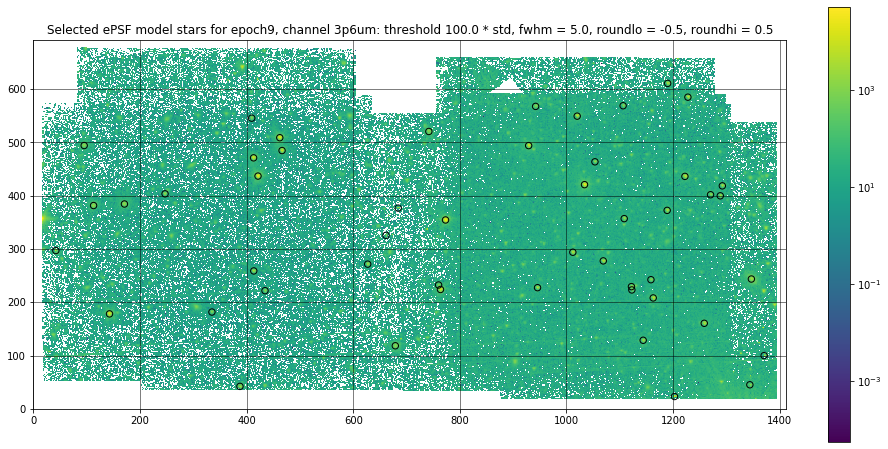

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1  1202.628354249369 ...  2836.582121555113                nan
  2  387.5374254844297 ...  2497.395923689105  39818.16817165889
  3 1343.9975710641036 ...  5102.257484034568 15567.013296329615
  4  1370.769069987769 ...   2180.63837051262 27168.654635470593
  5  678.9772497838895 ...  5469.431652728771  35355.33920771263
  6 1143.8722135360213 ... 3415.2595119805296 32473.977924186624
  7 1258.4732864706023 ... 3632.9447242238216   73149.7847887174
  8 142.88382677783295 ...  5551.088374218801  284670.0101170345
  9  334.9995731688378 ... 1452.8462370510754 17870.441280680854
 10 1162.7119904665553 ... 3697.2908799862084  99542.66289073239
...                ... ...                ...                ...
 41   95.3579936542737 ... 3779.8451959531994   38840.3017451114
 42   929.079877205538 ..

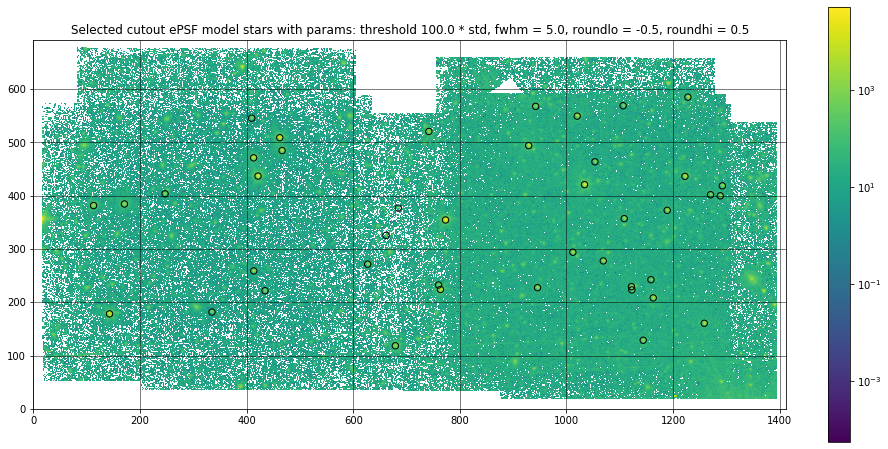

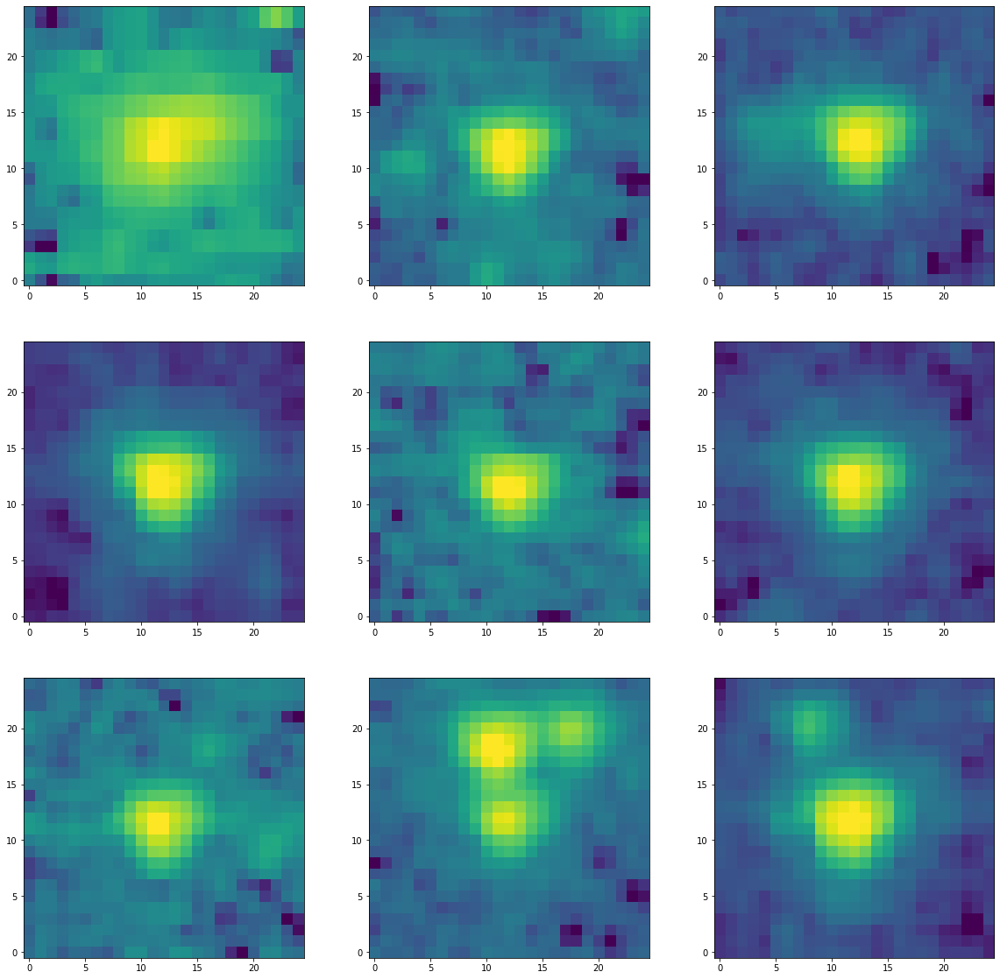

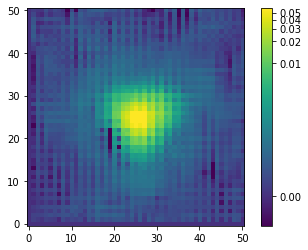

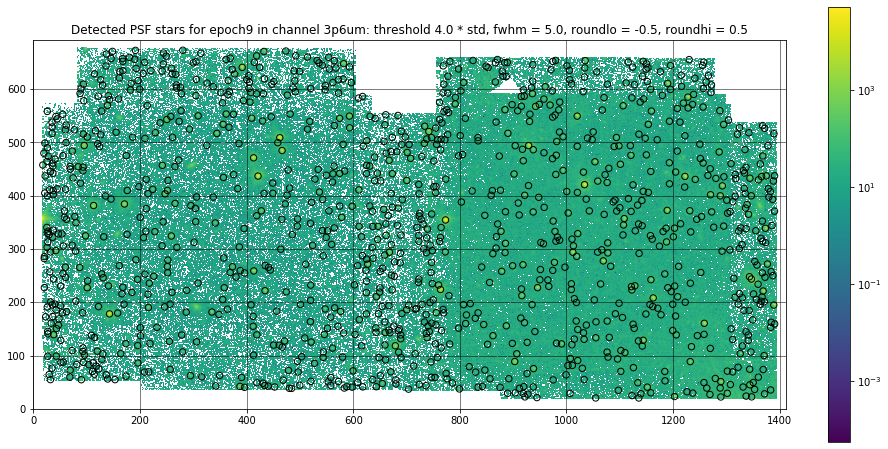

Number of stars detected = 1160


1449


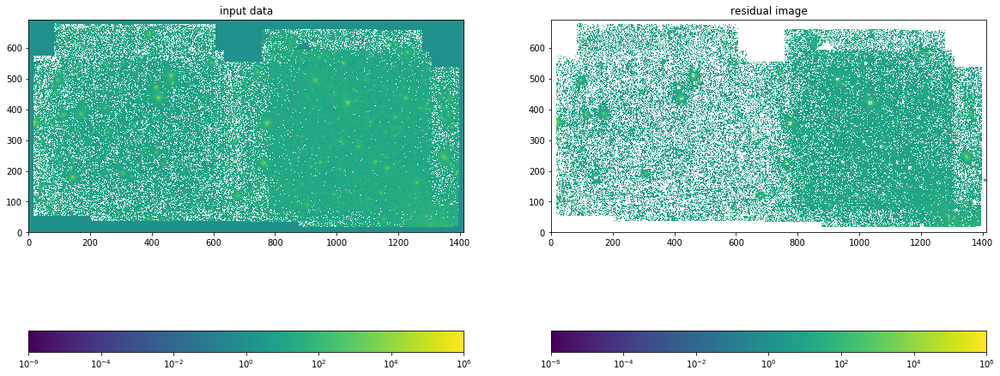

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 884.54815 19.728669  811.90604    18.283474
  2 912.74072 19.423635  426.00368    18.983705
  3 924.17308 19.220488  349.72272    19.197928
 17 927.68308 27.544798  903.54274    18.167366
 19 889.66964 29.155131  18.892627    22.366507
 20 918.83513 28.608203 -396.15162          nan
 23 903.84421 29.848738 -494.31818          nan
 39 911.69648 38.531737  1470.1882    17.638806
 42 875.42248 40.309862  974.93185    18.084802
 43 937.73443 40.815145  842.01412     18.24394
...       ...       ...        ...          ...
249   1123.91 641.05447  -931.9126          nan
250 1255.6902 644.38951 -658.00649          nan
252 243.65844 646.67764  135.65977     20.22611
255 866.72004 649.07364 -567.05072          nan
259 866.63237 655.13153  575.68013    18.656785
256 1193.1201 649.41359  1361.8984    17.721876
262 492.29476 662.31825 -268.92435          nan
263 465.89722 666.61256 -204.78127      

Number of model stars = 49


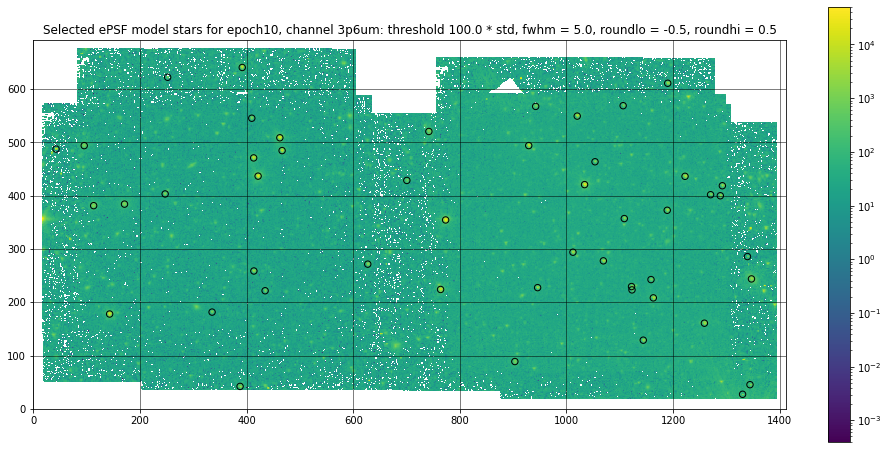

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1 1330.3600477599343 ...  8751.373146102882 12735.228433815215
  2 387.77233465370864 ...   3917.33958511266  40670.85215118861
  3  1344.226429618505 ...  6465.861182970234 15556.460461218998
  4  903.2026728106904 ... 5336.7162369032685 27061.014435201934
  5 1144.0508741537458 ...  4574.258372693454  32825.46343248167
  6  1258.748381921583 ...   4843.19631585766  72504.48087155589
  7 143.10029197207402 ...  7558.200225444767  285466.2839519121
  8 335.26820227584295 ... 2786.9591253790777 18387.888184480144
  9 1162.9278311943742 ...  5005.226895498501  99425.07993571738
 10 434.72414070965306 ...   3067.84158971153 16728.390676403695
...                ... ...                ...                ...
 40  929.2058120936547 ... 6741.0941518558275  148646.1908292671
 41  462.3550524110368 ..

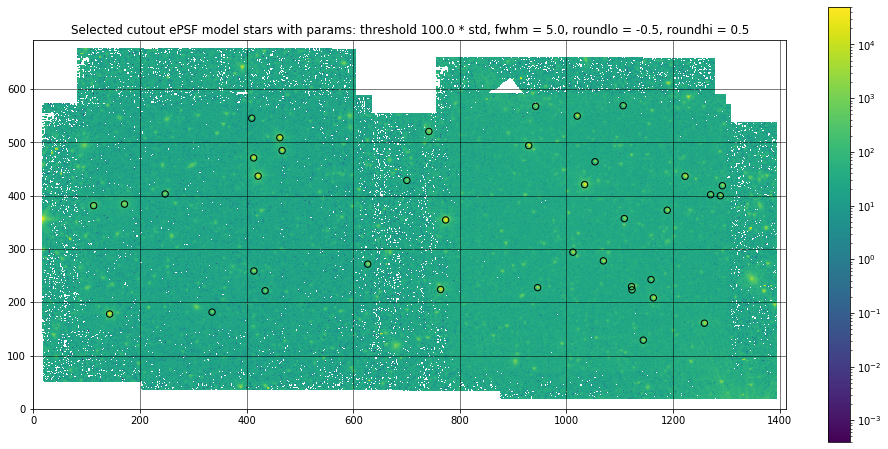

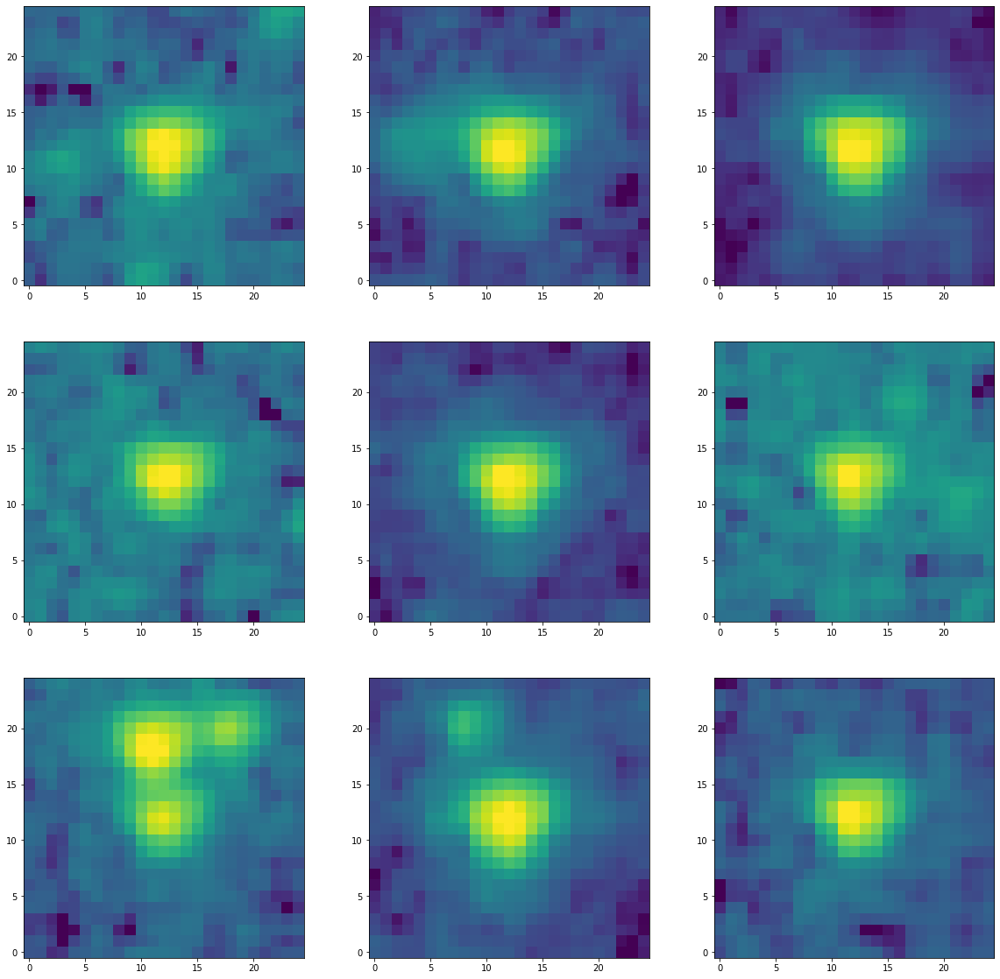

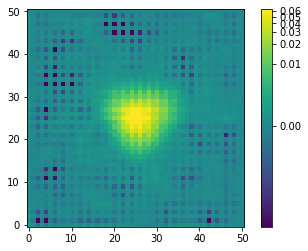

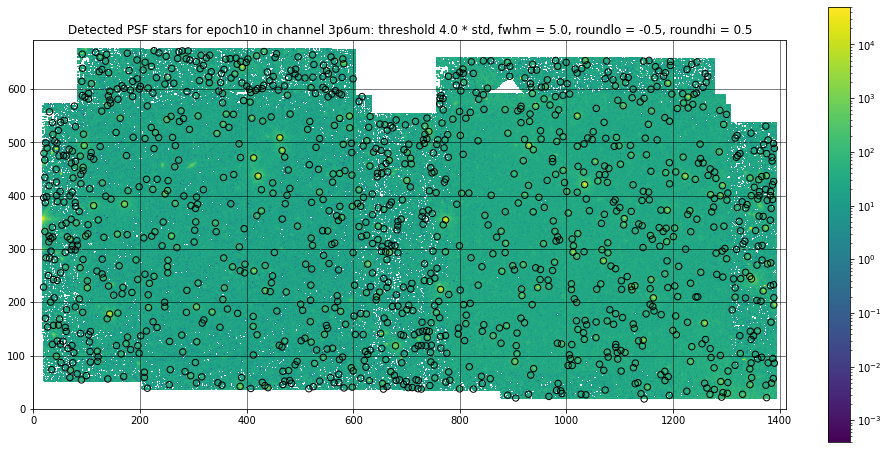

Number of stars detected = 1245


1699


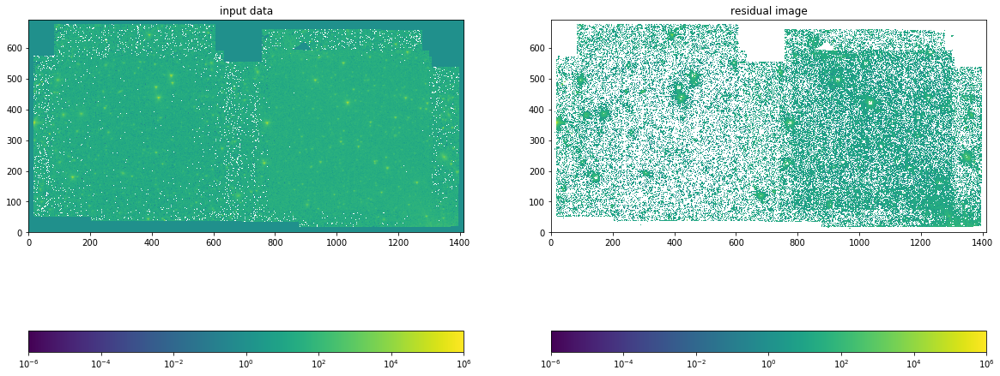

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1  954.2756 19.544348 -361.45316          nan
  2 963.01802 19.041819 -795.89252          nan
  3 967.68998 19.275944  -195.3141          nan
  9 967.01182 23.212818  234.96785    19.629641
 18 991.44893 28.716562  315.06819    19.311151
 23 989.35779 33.648169  635.46148    18.549439
 24 981.38338 34.570069 -273.81453          nan
 59 984.25463 47.593224  237.38864    19.618512
  4  1305.261 19.904763  6875.8572    15.963845
 15 1269.1493  27.04358   5483.191    16.209579
...       ...       ...        ...          ...
369 1147.8456 654.50685 -607.54132          nan
375 970.38243 657.01036 -1691.0619          nan
376 1042.5167   656.203  681.11995    18.474103
379 876.14118 657.33805 -805.95244          nan
380 884.45939 657.57077 -1205.9809          nan
382 558.59978 660.20359 -289.37331          nan
395 546.80262 673.76738 -1068.3045          nan
384 602.52357 661.80406 -949.56487      

Number of model stars = 44


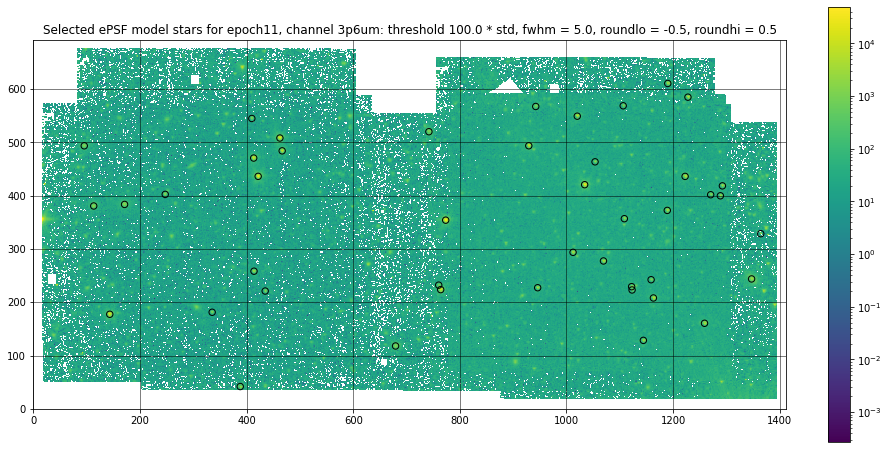

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1 388.09129123021216 ... 3328.8530466810853  38215.65749644231
  2  679.4364443807699 ...  5627.753210635203  37369.77575706084
  3 1144.2357610650727 ...  3724.478004985103  33282.53169347514
  4 1258.9778741119273 ...  4494.099152010697  73139.29870577814
  5 143.33873491568497 ...  6729.393713396229  289664.0106445039
  6  335.4149875253778 ... 2335.7698116388206 17783.993509804553
  7 1163.1046789670672 ...  4639.920612066497  98878.15571620298
  8  434.8660679243106 ... 2461.7165971589015  17040.15804273996
  9  764.0539599407107 ... 6481.1882396337905  226160.2205822509
 10 1123.0802508612544 ...  3873.764511924687  31650.49833225485
...                ... ...                ...                ...
 35  95.49493246738693 ...  5267.767779250477  38448.09442392952
 36  929.2999313549248 ..

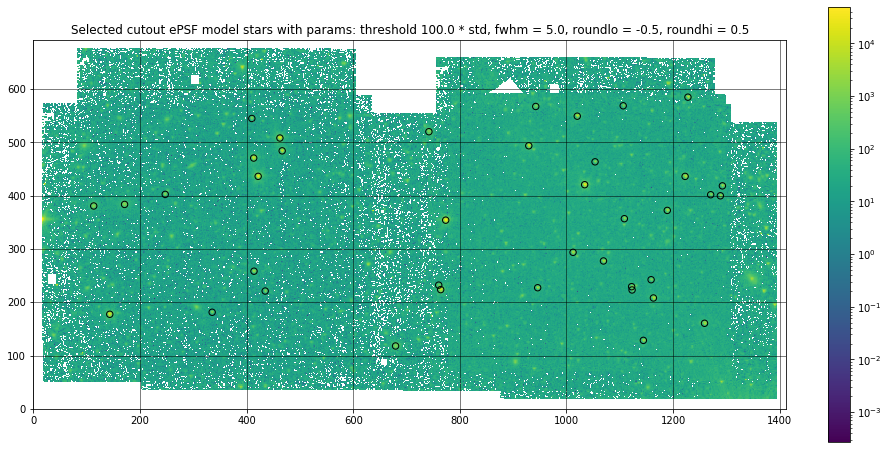

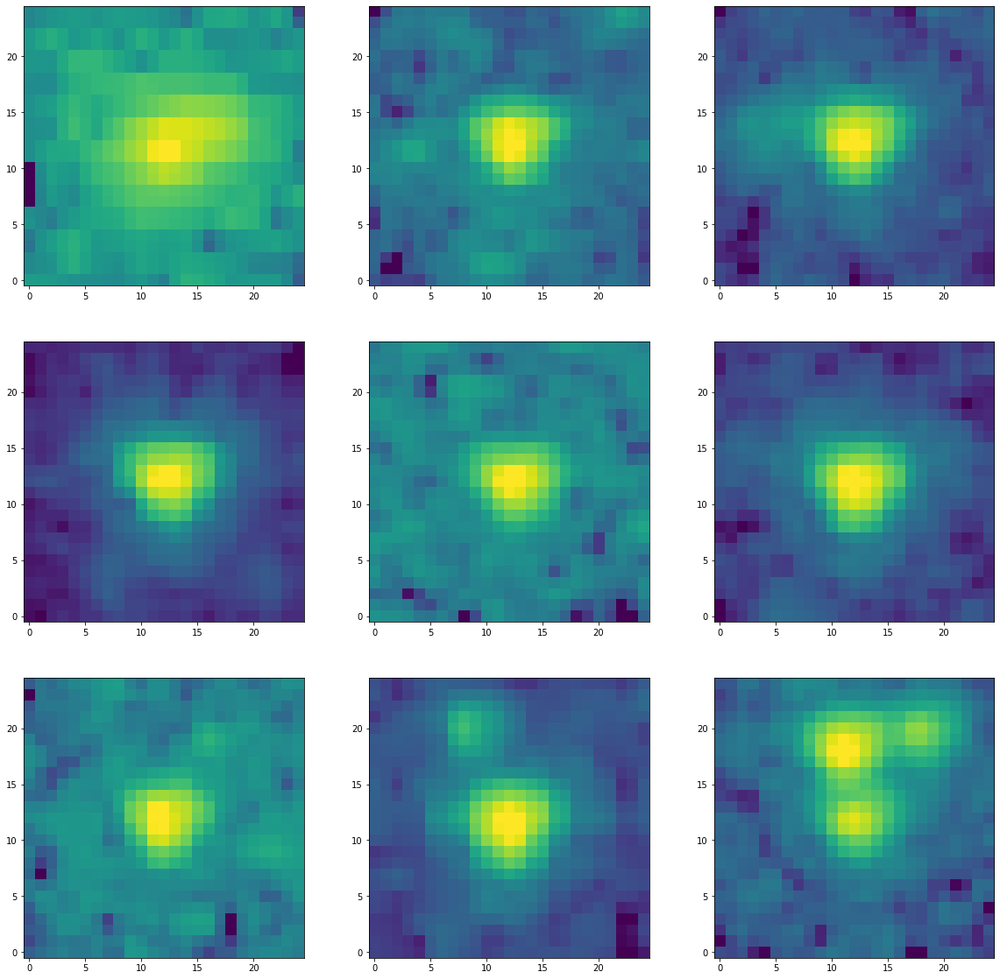

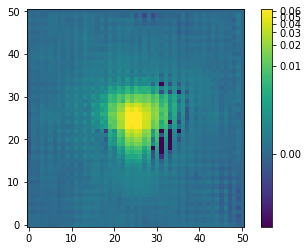

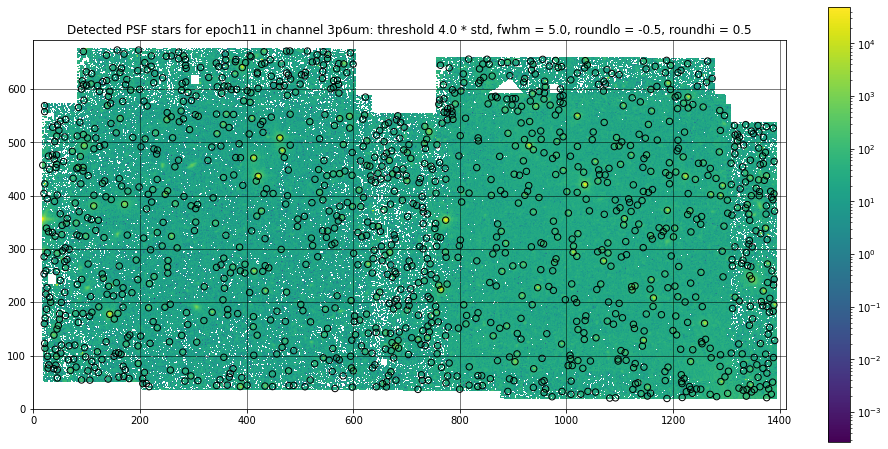

Number of stars detected = 1297


1674


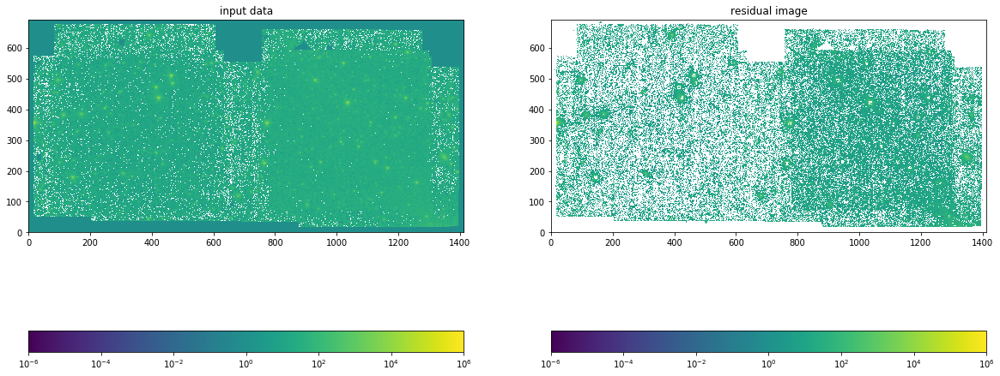

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 1157.8459 19.907959   807.7671    18.289119
  9 1151.9345 23.971512  1325.7327    17.751194
 13 1139.9345 28.507745  3209.1632    16.791354
 18 1157.6783  29.22034  1530.9292    17.594946
 30 1124.4961 36.518414  1301.6452    17.771102
 49 1151.9244 40.648225  16131.741    15.038131
 68 1129.4766 46.800043  5429.0455    16.220525
 71 1134.1303 48.886267  6194.0098    16.077404
  2  946.3362 20.944598  656.59192    18.514095
  7  973.0201 22.666435  1968.7582    17.321853
...       ...       ...        ...          ...
346 272.66059 669.11347  -631.1221          nan
352 260.80946 674.74245 -624.64001          nan
335 851.59169 655.97638 -184.71672          nan
336 1134.8341 656.42458 -911.33961          nan
343 170.10511  665.5489 -986.54407          nan
349 157.19485 673.17642 -1297.3088          nan
345 594.28278 667.86869 -685.08712          nan
351 595.03311 673.27072 -833.11668      

Number of model stars = 50


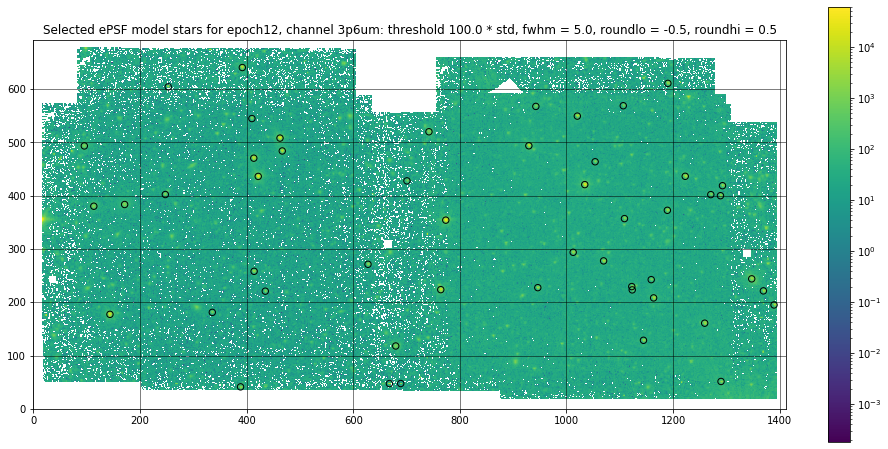

 id      xcenter       ...      aper_bkg       aper_sum_bkgsub  
           pix         ...                                      
--- ------------------ ... ------------------ ------------------
  1 388.66848950280547 ...  3044.369957928493                nan
  2   667.908760845211 ... 2155.9652003405727  68325.42827825794
  3  689.1320910975581 ...  2336.436158512008 13423.704617233103
  4 1289.8997713402027 ...  6367.676297859733  33307.96768919072
  5   679.755831267002 ...  5790.842093208985  35942.43853107856
  6  1144.460793023621 ... 4041.1068835387787  33233.73882147407
  7 1259.2720920849583 ...  4207.972091254039  74018.24172180668
  8 143.67735628723463 ...   6589.94407397501  289090.5711128907
  9  335.6793148317485 ...  2182.949552254068 17915.695698852236
 10 1389.3497229400048 ...   4429.06292060981                nan
...                ... ...                ...                ...
 41  929.4328955453543 ...  6282.896007990371 146854.83796470435
 42  462.6518314023736 ..

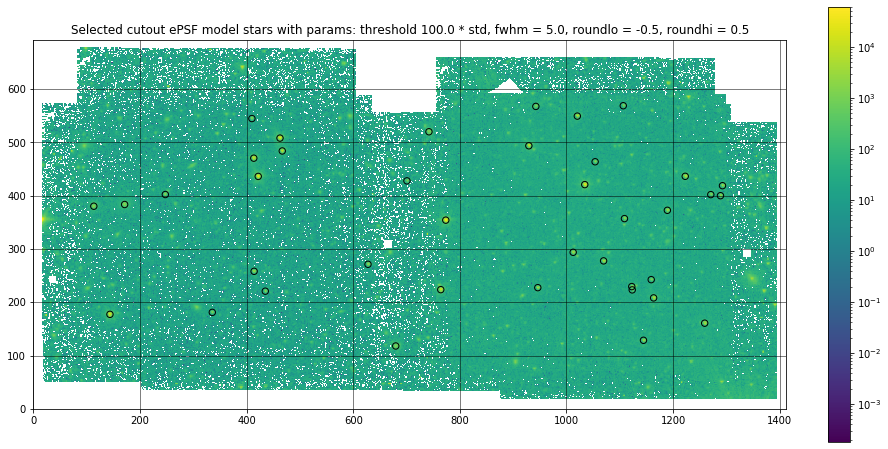

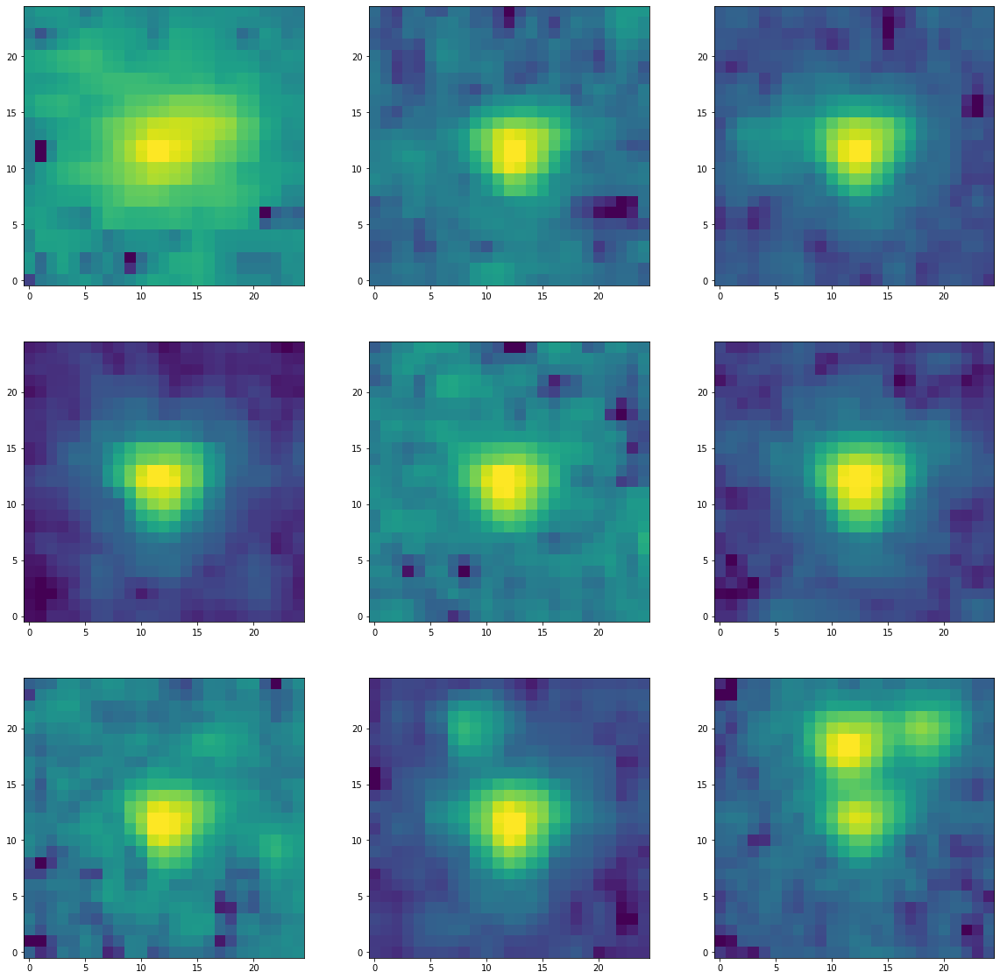

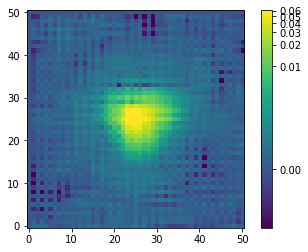

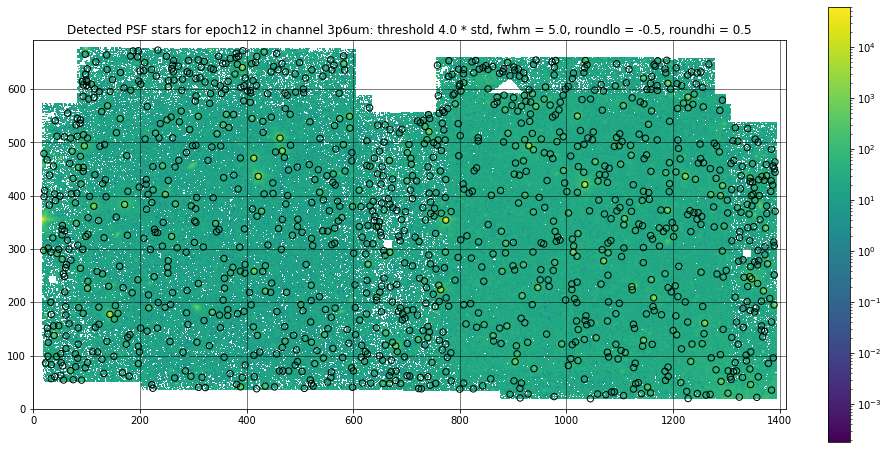

Number of stars detected = 1249


1586


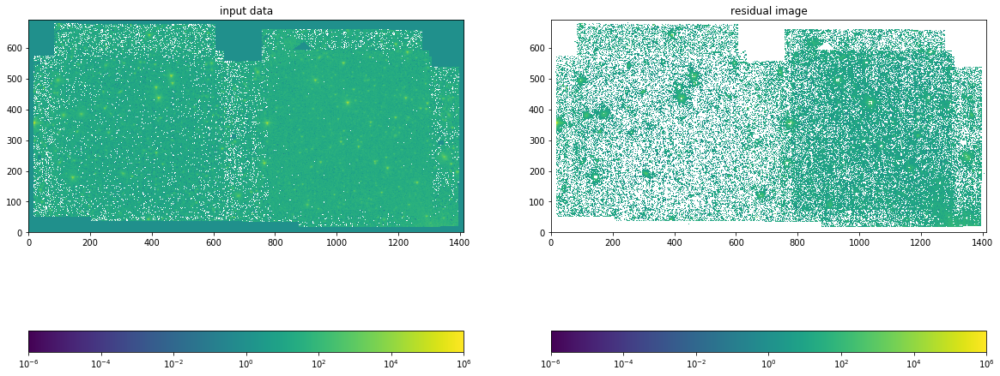

 id    x_0       y_0      flux_0   apparent_mag
--- --------- --------- ---------- ------------
  1 883.09964 18.745323 -738.58324          nan
 15  894.3242 27.296698  974.98588    18.084557
  2 922.15207 18.967499  27.004999    21.978442
 17 927.94953 27.861546   615.7959     18.58346
 40 912.67476 38.422757  1210.8286    17.849346
 66 915.49302 48.332497  1936.9814    17.339239
 75 901.48989  52.43739  1280.7845    17.788362
  3 1002.1057  18.93259 -497.57682          nan
  4 1080.3468 19.723989  104.14542    20.512952
 12 1107.0896 24.742848  7547.9727    15.862477
...       ...       ...        ...          ...
274 1168.0593 654.11758  66.649357    20.997562
275 383.57409  655.2657  571.49954    18.664513
276 764.19274 657.28032  936.63795    18.128123
277 195.58353 660.06007  205.15028    19.776872
280 187.03097 671.31852 -224.96333          nan
279 456.38017 666.40665 -1531.6195          nan
281  233.7516 673.04767 -523.64531          nan
282 246.93998 675.08705 -1560.3732      

In [8]:
## BASE DATA DIRECTORY ##

base_dir = 'PAL5_data/*/'
channel = '3p6um'

## PARAMETERS ##

sigma_val = 4.
fwhm = 5.
model_threshold = 100.
r_ap = 6.
r_in = 6.
r_out = 14.
roundlo = -0.5
roundhi = 0.5
sharphi = 0.8

## LOOP COUNTER ##
j = 0

## FITS FILE SELECTION ##

for file in glob.glob(base_dir+'PAL5__e[0-9]_'+channel+'.fits', recursive = True) + glob.glob(base_dir+'PAL5__e[0-9][0-9]_'+channel+'.fits', recursive = True):
    j += 1
    print('EPOCH NUMBER: {}'.format(j))
    ## OPENING FITS FILE AND EXTRACTING DATA ##
    with fits.open(file) as header_list:
        header = header_list[0].header
        fluxconv = header['FLUXCONV']
        exptime = header['EXPTIME']
        counts = exptime / fluxconv
        image_data = fits.getdata(file, ext = 0)
        data = image_data * counts
        print('FLUXCONV = {}\nEXPTIME = {}'.format(fluxconv, exptime))

    ## SOURCE DETECTION ##
    
    mean, median, std = sigma_clipped_stats(data, sigma = sigma_val)

    starfind_init = DAOStarFinder(fwhm = fwhm, threshold = model_threshold * std, roundlo = roundlo, roundhi = roundhi, sharphi = sharphi)
    epsf_sources = starfind_init(data)
    print('Number of model stars = {}'.format(len(epsf_sources)))

    # plot detected stars for ePSF model to verify good stars
    positions = np.transpose((epsf_sources['xcentroid'], epsf_sources['ycentroid']))
    apertures = CircularAperture(positions, r = 6.)

    plt.imshow(data, cmap = 'viridis', origin = 'lower', norm = LogNorm(), interpolation = 'nearest')
    apertures.plot(color = 'black', lw = 1.)
    plt.colorbar(fraction = 0.05)
    plt.title('Selected ePSF model stars for epoch{}, channel {}: threshold {} * std, fwhm = {}, roundlo = {}, roundhi = {}'
              .format(j, channel, model_threshold, fwhm, roundlo, roundhi))
    plt.grid(b = True, which = 'major', lw = .5, color = 'black')
    plt.grid(b = True, which = 'minor', lw = .5, color = 'black')
    plt.gcf().set_size_inches(15, 8)
    plt.show()
    plt.close()
    
    ## APERTURE PHOTOMETRY ON MODEL STARS ##
    
    positions = np.transpose((epsf_sources['xcentroid'], epsf_sources['ycentroid']))
    circular_apertures = CircularAperture(positions, r = 6.)
    annuli_apertures = CircularAnnulus(positions, r_in = 6., r_out = 14.)
    apertures = [circular_apertures, annuli_apertures]

    # initial aperture photometry table
    phot_init = aperture_photometry(data, apertures)

    # background subtraction using sigma-clipped median and annuli
    annulus_masks = annuli_apertures.to_mask(method = 'center')

    bkg_median = []
    for mask in annulus_masks:
        annulus_data = mask.multiply(data)
        annulus_data_1d = annulus_data[mask.data > 0] # extract 1D array of data values
        _, median_sigclip, _ = sigma_clipped_stats(annulus_data_1d) # utilise sigma clipping on the annulus masks
        bkg_median.append(median_sigclip)

    bkg_median = np.array(bkg_median)
    # now append bkg_median, aperture background and aperture sum background values to photometry data
    phot_init['annulus_median'] = bkg_median
    phot_init['aper_bkg'] = bkg_median * circular_apertures.area
    phot_init['aper_sum_bkgsub'] = phot_init['aperture_sum_0'] - phot_init['aper_bkg']
    print(phot_init)
    
    ## STAR CUTOUTS FOR ePSF ##

    cutout_size = 200
    hsize = (cutout_size - 1) / 2
    x = epsf_sources['xcentroid']
    y = epsf_sources['ycentroid']
    mask = ((x > hsize) & (x < (data.shape[1] - 1 - hsize)) &
           (y > hsize) & (y < (data.shape[0] - 1 - hsize)))

    # table of star positions
    star_tbl = Table()
    star_tbl['x'] = x[mask]
    star_tbl['y'] = y[mask]
    print('Number of refined model stars = {}'.format(len(star_tbl)))

    # visualise stars to verify - not strictly necessary as visual checks should be done before using this script
    cutout_pos = np.transpose((star_tbl['x'], star_tbl['y']))
    cutout_apers = CircularAperture(cutout_pos, r = 6.)

    plt.imshow(data, cmap = 'viridis', origin = 'lower', norm = LogNorm(), interpolation = 'nearest')
    cutout_apers.plot(color = 'black', lw = 1.)
    plt.colorbar(fraction = 0.05)
    plt.title('Selected cutout ePSF model stars with params: threshold {} * std, fwhm = {}, roundlo = {}, roundhi = {}'
              .format(model_threshold, fwhm, roundlo, roundhi))
    plt.grid(b = True, which = 'major', lw = .5, color = 'black')
    plt.grid(b = True, which = 'minor', lw = .5, color = 'black')
    plt.gcf().set_size_inches(15, 8)
    plt.show()
    plt.close()
    
    ## EXTRACT STARS ##

    mean_val, median_val, std_val = sigma_clipped_stats(data, sigma = sigma_val)
    sub_data = data - median_val

    nddata = NDData(data = sub_data)
    stars = extract_stars(nddata, star_tbl, size = 25)

    # visualise 36 extracted stars
    nrows = 3
    ncols = 3
    fig, ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = (20,20), squeeze = True)
    ax = ax.ravel()
    for i in range(nrows * ncols):
        norm = simple_norm(stars[i], 'log', percent = 99.)
        ax[i].imshow(stars[i], cmap = 'viridis', norm = norm, origin = 'lower')
    plt.show()
    plt.close()

    ## BUILD ePSF ##

    epsf_builder = EPSFBuilder(oversampling = 2, maxiters = 10, progress_bar = True)
    epsf, fitter = epsf_builder(stars)

    norm = simple_norm(epsf.data, 'log', percent = 99.)
    plt.imshow(epsf.data, cmap = 'viridis', norm = norm, origin = 'lower')
    plt.colorbar()
    plt.show()
    plt.close()
    
    ## PSF PHOTOMETRY ##

    ## SOURCE DETECTION ON ORIGINAL IMAGE ##
    # PARAMETERS #

    psf_daofind = DAOStarFinder(fwhm = fwhm, threshold = sigma_val * std, roundlo = roundlo, roundhi = roundhi)
    psf_sources = psf_daofind(data)

    psf_positions = np.transpose((psf_sources['xcentroid'], psf_sources['ycentroid']))
    psf_apertures = CircularAperture(psf_positions, r = 6.)

    plt.imshow(data, cmap = 'viridis', origin = 'lower', norm = LogNorm(), interpolation = 'nearest')
    psf_apertures.plot(color = 'black', lw = 1.)
    plt.colorbar(fraction = 0.05)
    plt.title('Detected PSF stars for epoch{} in channel {}: threshold {} * std, fwhm = {}, roundlo = {}, roundhi = {}'
              .format(j, channel, sigma_val, fwhm, roundlo, roundhi))
    plt.grid(b = True, which = 'major', lw = .5, color = 'black')
    plt.grid(b = True, which = 'minor', lw = .5, color = 'black')
    plt.gcf().set_size_inches(15, 8)
    plt.show()

    print('Number of stars detected = {}'.format(len(psf_sources)))

    ## GROUP ##

    psf_sources['xcentroid'].name = 'x_0'
    psf_sources['ycentroid'].name = 'y_0'

    daogroup = DAOGroup(crit_separation = sigma_val * fwhm)
    bkg_estimator = MMMBackground()
    fitter = LevMarLSQFitter()

    data_psf = np.nan_to_num(data, nan = 1**-7)

    ## PHOTOMETRY ##

    PSF_photometry = IterativelySubtractedPSFPhotometry(finder = psf_daofind,
                                                        group_maker = daogroup,
                                                        bkg_estimator = bkg_estimator,
                                                        psf_model = epsf,
                                                        fitter = fitter,
                                                        niters = 2,
                                                        aperture_radius = 6.,
                                                        fitshape = (11, 11))

    result_phot = PSF_photometry(image = data_psf)
    residual_image = PSF_photometry.get_residual_image()
    print(len(result_phot))
    # visualise data
    plt.subplot(1, 2, 1)
    plt.imshow(data_psf, cmap = 'viridis', norm = LogNorm(), interpolation = 'nearest', origin = 'lower', vmin = 0.000001, vmax = 10**6)
    plt.title('input data')
    plt.colorbar(orientation = 'horizontal')

    plt.subplot(1, 2, 2)
    plt.imshow(residual_image, cmap = 'viridis', norm = LogNorm(), interpolation = 'nearest', origin = 'lower', vmin = 0.000001, vmax = 10**6)
    plt.title('residual image')
    plt.colorbar(orientation = 'horizontal')
    plt.gcf().set_size_inches(20, 14)
    plt.show()
    plt.close()
    
    ## APPARENT MAGNITUDES ##
    aper_corr = 1.125      # aperture correction for 337 (6,6,14) apertures in channel 1, given in IRAC handbook §4.10
    zmag = 18.8            # from IRAC handbook §4.8

    phot = result_phot                  # redefine photometry table for ease
    phot['bkgsub_flux'] = float('NaN')  # populate new column to convert into flux
    phot['apparent_mag'] = float('NaN') # populate a new table (very quirky here, nans?)

    for i in range(0, len(phot)):
        phot['bkgsub_flux'][i] = phot['flux_0'][i] * fluxconv / exptime
        for i in range(0, len(phot)):
            if phot['bkgsub_flux'][i] >= 0:
                phot['apparent_mag'][i] = zmag - 2.5 * math.log10(phot['bkgsub_flux'][i] * aper_corr)

    # export into csv file
    phot['id', 'x_0', 'y_0', 'apparent_mag'].write(r'C:\Users\lukeb\Documents\MPhys_RRLs\output_files\psfphot_epoch{}_{}.txt'.format(j, channel), format = 'csv', overwrite = True)

    # format columns
    for col in phot.colnames:
        phot[col].info.format = '%.8g'
    print(phot['id', 'x_0', 'y_0', 'flux_0', 'apparent_mag'])